<a href="https://colab.research.google.com/github/RostislavKorst/Generative-Models-2024/blob/main/Assignment%201/1_gan_dcgan.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Generative Models
***

**Autumn 2024**


## Assignment 1

***


*Authored by Arip Asadulaev & Manh Lab*

*Adapted by Alexander Panfilov*

***


The assignment is split into two parts: at first, you will implement classical GAN for the MNIST dataset, and after, you will enhance your results with DCGAN and the CIFAR dataset.

Good luck!

## 1. GAN
*Source: <a href="https://arxiv.org/pdf/1406.2661.pdf" target="_blank">Goodfellow, Ian J., et al. "Generative Adversarial Networks." arXiv preprint arXiv:1406.2661 (2014)</a>.*

In 2014, Ian Goodfellow and his colleagues at the University of Montreal published a stunning paper introducing the world to GANs, or generative adversarial networks. The models play two distinct (literally, adversarial) roles. Given some real data set $\mathcal{X}$, $G$ is the generator, trying to create fake data that looks just like the genuine data, while $D$ is the discriminator, getting data from either the real set or $G$ and labeling the difference.

Goodfellow’s metaphor (and a fine one it is) was that $G$ was like a team of forgers trying to match real paintings with their output, while $D$ was the team of detectives trying to tell the difference. (Except in this case, the forgers $G$ never get to see the original data — only the judgments of $D$. They’re like blind forgers.)

<img src="https://production-media.paperswithcode.com/methods/gan.jpeg" style="display=block; margin:auto"/>
<p style="text-align: center">
    <b>Picture taken from the <a href="https://paperswithcode.com/method/gan" target="_blank">paperswithcode</a> website. There you can find a whole bunch of papers on GANs with implementation.</b>
</p>

In this part, we are going to implement classical GAN. You can find a rough plan on how to do it below; however, it is not mandatory to stick with it precisely but one might expect some questions related to the listed steps. Feel free to adapt provided code!

- Define the parameters
- Load the data (with transforms and normalization)
- Denormalize for visual inspection of samples
- Define the Discriminator network, the Generator network
- Study the activation function: Leaky ReLU
- Explain the output activation function: Tanh, Sigmoid
- Look at some sample outputs
- Define losses, optimizers and helper functions for training
     - For Discriminator
     - For Generator
- Train the model
- Save intermediate generated images to file
- Look at some outputs
- Save the models

### Imports

In [1]:
import os
import random

import matplotlib.pyplot as plt
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
from PIL import Image
from torchvision import transforms
from torchvision.datasets import CIFAR10, MNIST
from torchvision.transforms import Compose, Normalize, ToTensor
from torchvision.utils import save_image
from tqdm import tqdm

%matplotlib inline
plt.style.use("ggplot")

### Define parameters & data loading

In [39]:
hidden_size = 256
batch_size = 100
LR = 0.0002
num_epochs = 300
sample_dir = "./images"
latent_size = 64  # input random input vector latent
image_size = 784  # 28*28 flatten
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
ngpu = torch.cuda.device_count()

if not os.path.exists(sample_dir):
    os.makedirs(sample_dir)

## Define the dataset
mnist_dataset = MNIST(
    root="data",
    train=True,
    download=True,
    transform=Compose([ToTensor(), Normalize(mean=(0.5,), std=(0.5,))]),
)

Label:  5


(array([55.,  4.,  3.,  0.,  3.,  2.,  1.,  0.,  1.,  3.,  1.,  3.,  2.,
         1., 21.]),
 array([-1.        , -0.86771244, -0.73542482, -0.60313725, -0.47084966,
        -0.3385621 , -0.20627451, -0.07398693,  0.05830066,  0.19058824,
         0.32287583,  0.45516339,  0.58745098,  0.71973854,  0.85202616,
         0.98431373]),
 <BarContainer object of 15 artists>)

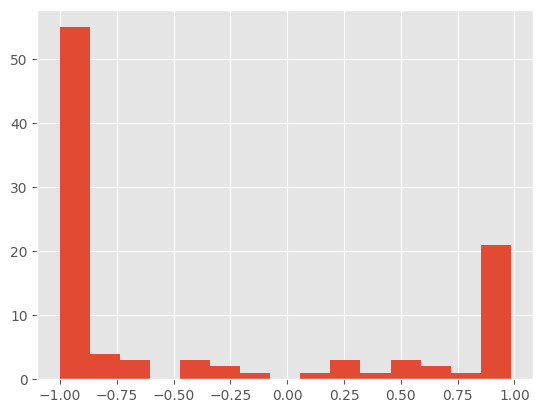

In [40]:
img, label = mnist_dataset[0]
print("Label: ", label)
plt.hist(img[:, 5:15, 5:15].flatten(), bins=15)

In [41]:
# denormalization image from range (-1)-1 to range 0-1 to display it
def denorm(x):
    x_min = x.min()
    x_max = x.max()
    x = (x - x_min) / (x_max - x_min)
    return x

img.shape=torch.Size([1, 28, 28])


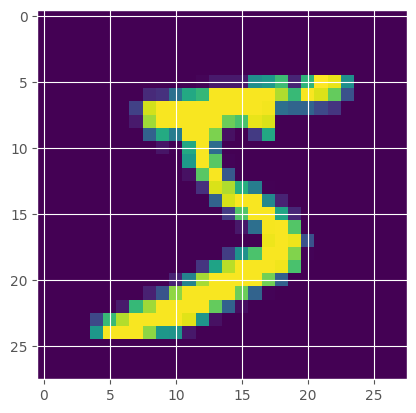

In [42]:
# show image sample with matplotlib
print(f"{img.shape=}")

plt.imshow(denorm(img.squeeze(0)))
plt.show()

(array([55.,  4.,  3.,  0.,  3.,  2.,  1.,  0.,  1.,  3.,  1.,  3.,  2.,
         1., 21.]),
 array([0.        , 0.06614379, 0.13228758, 0.19843137, 0.26457515,
        0.33071896, 0.39686275, 0.46300653, 0.52915031, 0.59529412,
        0.66143793, 0.72758168, 0.79372549, 0.8598693 , 0.92601305,
        0.99215686]),
 <BarContainer object of 15 artists>)

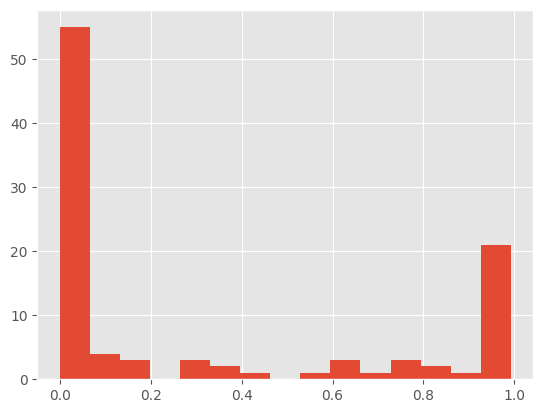

In [43]:
plt.hist(denorm(img)[:, 5:15, 5:15].flatten(), bins=15)

In [44]:
# define the dataloader
from torch.utils.data import DataLoader

data_loader = DataLoader(
    mnist_dataset, 
    batch_size=batch_size, 
    shuffle=True)

### GAN implementation

GAN consists of two deep networks, a generator ($G$) and a discriminator ($D$). The generator creates images before learning it. Since the discriminator is a binary classification model, we can use the binary cross-entropy loss function to quantify how well it can distinguish between real and generated images.

In [47]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [48]:
class Generator(nn.Module):
    def __init__(self, latent_size, image_size, hidden_size):
        super(Generator, self).__init__()
        # set a linear layer with input size is latent_size and output size is hidden_size
        self.linear1 = nn.Linear(latent_size, hidden_size)

        # set a linear layer with input size is hidden_size and output size is hidden_size
        self.linear2 = nn.Linear(hidden_size, hidden_size)
        
        # set a linear layer with input size is hidden_size and output size is image_size
        self.linear3 = nn.Linear(hidden_size, image_size)
        
        self.relu = nn.ReLU() # output in range [0, +inf]
        self.tanh = nn.Tanh() # output in range [-1, 1]
        
    def forward(self, x):
        # forward x -> linear1 -> relu -> linear2 -> relu -> linear3 -> tanh
        x = self.relu(self.linear1(x))
        x = self.relu(self.linear2(x))
        x = self.tanh(self.linear3(x))
        return x


class Discriminator(nn.Module):
    def __init__(self, image_size, hidden_size):
        super(Discriminator, self).__init__()
        # set a linear layer with input size is image_size and output size is hidden_size
        self.linear1 = nn.Linear(in_features=image_size, out_features=hidden_size)

        # set a linear layer with input size is hidden_size and output size is hidden_size
        self.linear2 = nn.Linear(hidden_size, hidden_size)

        # set a linear layer with input size is hidden_size and output size is 1
        self.linear3 = nn.Linear(hidden_size, 1)
        
        self.relu = nn.ReLU()
        self.sigmoid = nn.Sigmoid() # output pixel in range [0, 1]
        
    def forward(self, x):
        # forward x -> linear1 -> relu -> linear2 -> relu -> linear3 -> sigmoid
        x = self.relu(self.linear1(x))
        x = self.relu(self.linear2(x))
        x = self.sigmoid(self.linear3(x))
        return x

### Create the Generator and Discriminator

In [59]:
# Create the generator
G = Generator(latent_size, image_size, hidden_size).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    G = nn.DataParallel(G, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights to mean=0, stdev=0.2.
G.apply(weights_init)

DataParallel(
  (module): Generator(
    (linear1): Linear(in_features=64, out_features=256, bias=True)
    (linear2): Linear(in_features=256, out_features=256, bias=True)
    (linear3): Linear(in_features=256, out_features=784, bias=True)
    (relu): ReLU()
    (tanh): Tanh()
  )
)

In [60]:
# Create the Discriminator
D = Discriminator(image_size, hidden_size).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    D = nn.DataParallel(D, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights to mean=0, stdev=0.2.
D.apply(weights_init)

DataParallel(
  (module): Discriminator(
    (linear1): Linear(in_features=784, out_features=256, bias=True)
    (linear2): Linear(in_features=256, out_features=256, bias=True)
    (linear3): Linear(in_features=256, out_features=1, bias=True)
    (relu): ReLU()
    (sigmoid): Sigmoid()
  )
)

In [61]:
# show the output of model
y = G(torch.randn(2, latent_size).to(device))
print(f"{y.shape=}")

y.shape=torch.Size([2, 784])


In [62]:
# define the criterion is nn.BCELoss()

criterion = nn.BCELoss()

# define the optimizer for generator and discrimator

G_optimizer = torch.optim.Adam(G.parameters(), lr=LR)
D_optimizer = torch.optim.Adam(D.parameters(), lr=LR)

Discriminator Training

In [63]:
def reset_grad():
    # reset gradient for optimizer of generator and discrimator
    G_optimizer.zero_grad()
    D_optimizer.zero_grad()

def train_discriminator(D_model, G_model, images):
    # Create the labels which are later used as input for the BCE loss
    real_labels = torch.ones(batch_size).to(device) # requires_grad=False by default
    fake_labels = torch.zeros(batch_size).to(device) # requires_grad=False by default

    real_score = D_model(images).view(-1)
    
    # Loss for real images
    real_loss = criterion(real_score, real_labels)
    
    # Loss for fake images
    z = torch.randn(batch_size, latent_size).to(device) # requires_grad=False by default
    fake_images = G_model(z)
    
    fake_score = D_model(fake_images.detach()).view(-1)
    
    fake_loss = criterion(fake_score, fake_labels)

    # Sum losses
    d_loss = (real_loss + fake_loss) / 2

    # Reset gradients
    reset_grad()

    # Compute gradients
    d_loss.backward()

    # Adjust the parameters using backprop
    D_optimizer.step()
    
    return d_loss, real_score, fake_score

Generator Training

In [64]:
def train_generator(G_model, D_model):
    # Generate fake images and calculate loss
    z = torch.randn(batch_size, latent_size).to(device) # requires_grad=False by default
    
    fake_images = G_model(z)
    labels = torch.ones(batch_size).to(device) # requires_grad=False by default

    fake_score = D_model(fake_images).view(-1)
    
    # calculate the generator loss
    g_loss  = criterion(fake_score, labels)

    # Reset gradients
    reset_grad()

    # Backprop and optimize
    g_loss.backward()
    G_optimizer.step()

    return g_loss, fake_images

### Start the training proccess

In [65]:
from PIL import Image

# function to save the sample output of generator
def save_fake_images_mnist(G_model, index, show_image=False):
    with torch.inference_mode():
        sample_vectors = torch.randn(batch_size, latent_size).to(device)
        fake_images = G_model(sample_vectors)
        fake_images = fake_images.reshape(fake_images.size(0), 1, 28, 28)
        fake_fname = "fake_images-{0:0=4d}.png".format(index)
        print("Saving", fake_fname)
        path = os.path.join(sample_dir, fake_fname)
        save_image(denorm(fake_images), path, nrow=10)

        # show output after epochs training
        if show_image:
            plt.figure(figsize=(10, 10))
            plt.grid(False)
            plt.imshow(np.asarray(Image.open(path)))
            plt.show()

  0%|          | 0/300 [00:23<?, ?it/s, Epoch=0/300, Step=600/600, D_Loss=0.0602, G_Loss=3.9933, D(x)=0.94, D(G(z))=0.06]

Saving fake_images-0001.png


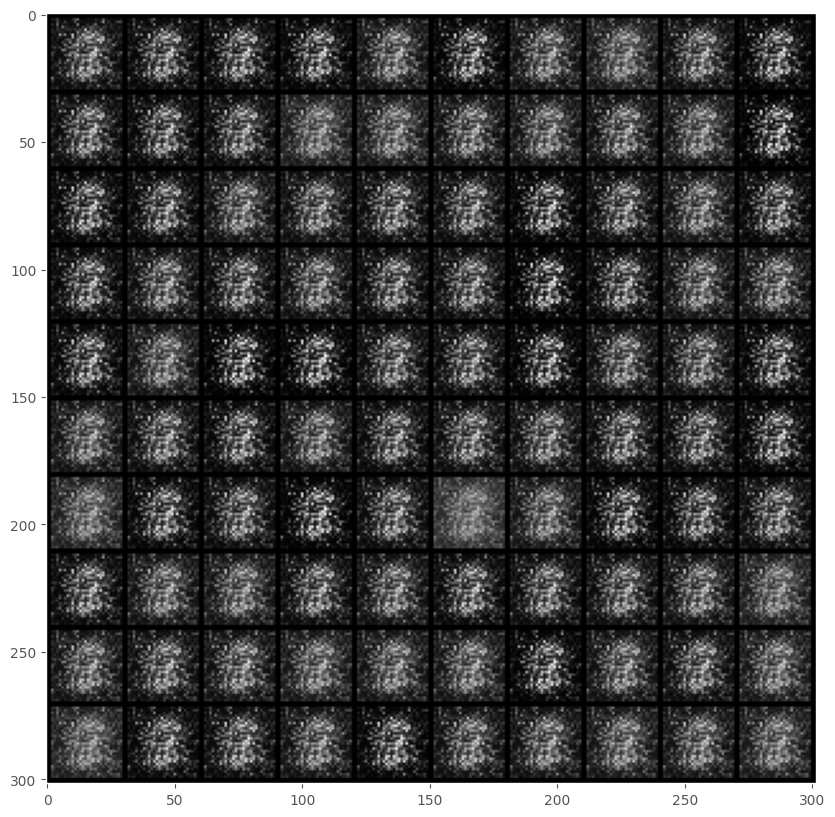

  3%|▎         | 10/300 [04:21<1:55:35, 23.91s/it, Epoch=10/300, Step=600/600, D_Loss=0.4642, G_Loss=1.3363, D(x)=0.74, D(G(z))=0.41]

Saving fake_images-0011.png


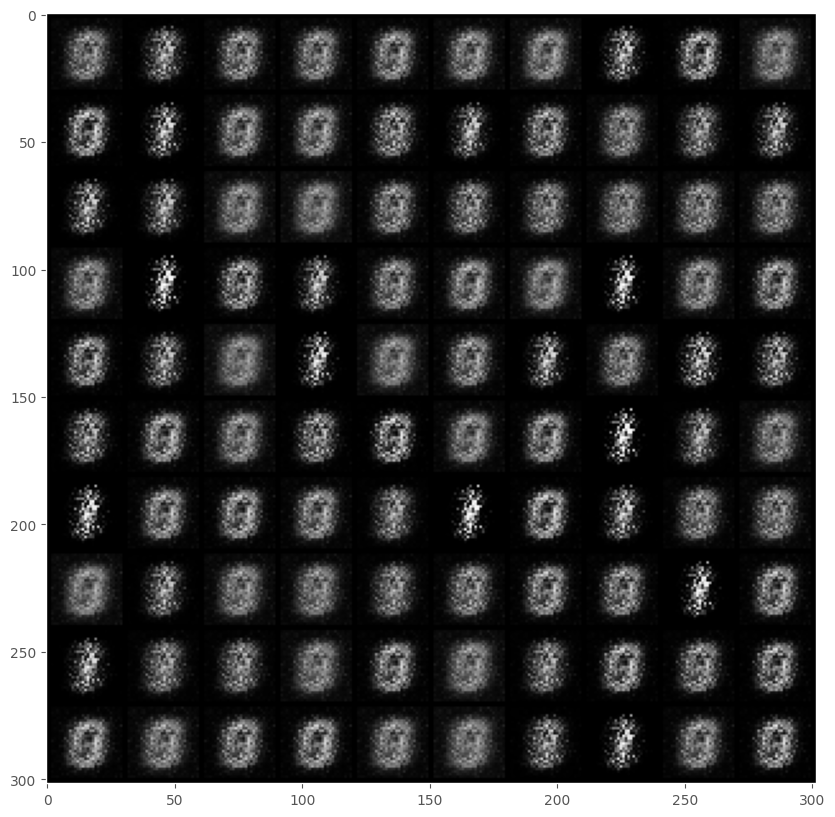

  7%|▋         | 20/300 [08:20<1:51:42, 23.94s/it, Epoch=20/300, Step=600/600, D_Loss=0.8275, G_Loss=0.8098, D(x)=0.56, D(G(z))=0.52]

Saving fake_images-0021.png


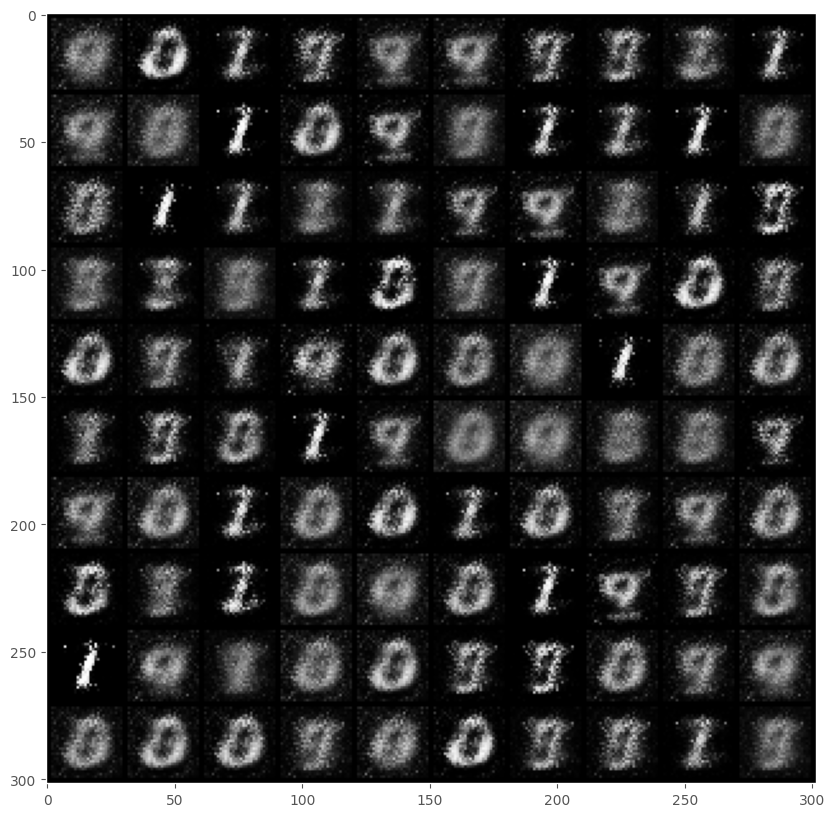

 10%|█         | 30/300 [12:19<1:47:13, 23.83s/it, Epoch=30/300, Step=600/600, D_Loss=0.3469, G_Loss=2.5582, D(x)=0.80, D(G(z))=0.26]

Saving fake_images-0031.png


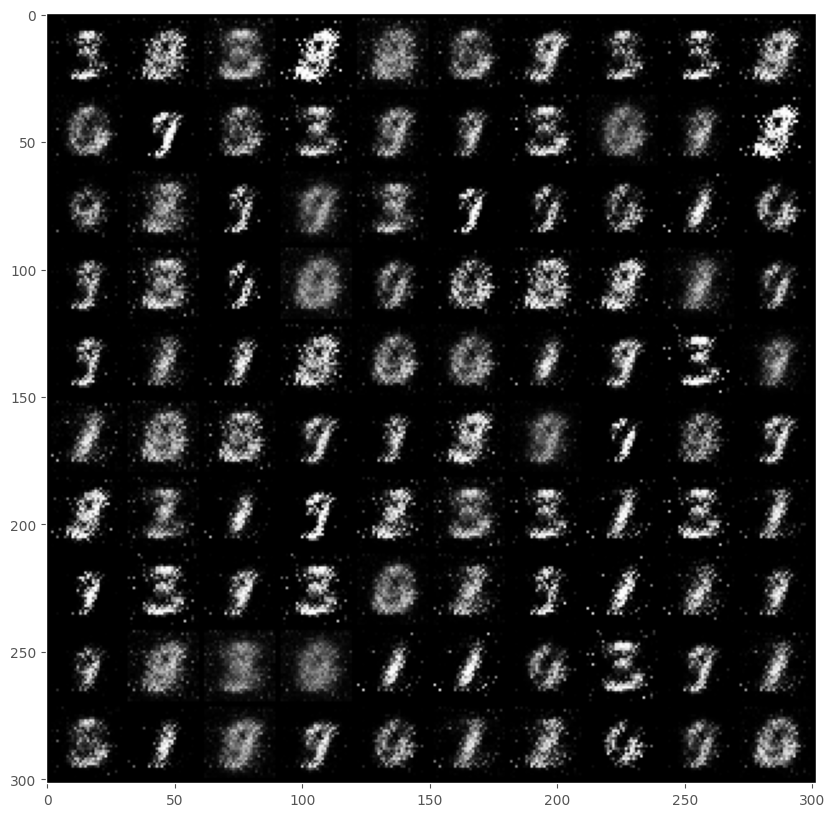

 13%|█▎        | 40/300 [16:15<1:41:34, 23.44s/it, Epoch=40/300, Step=600/600, D_Loss=0.3328, G_Loss=2.6816, D(x)=0.84, D(G(z))=0.27]

Saving fake_images-0041.png


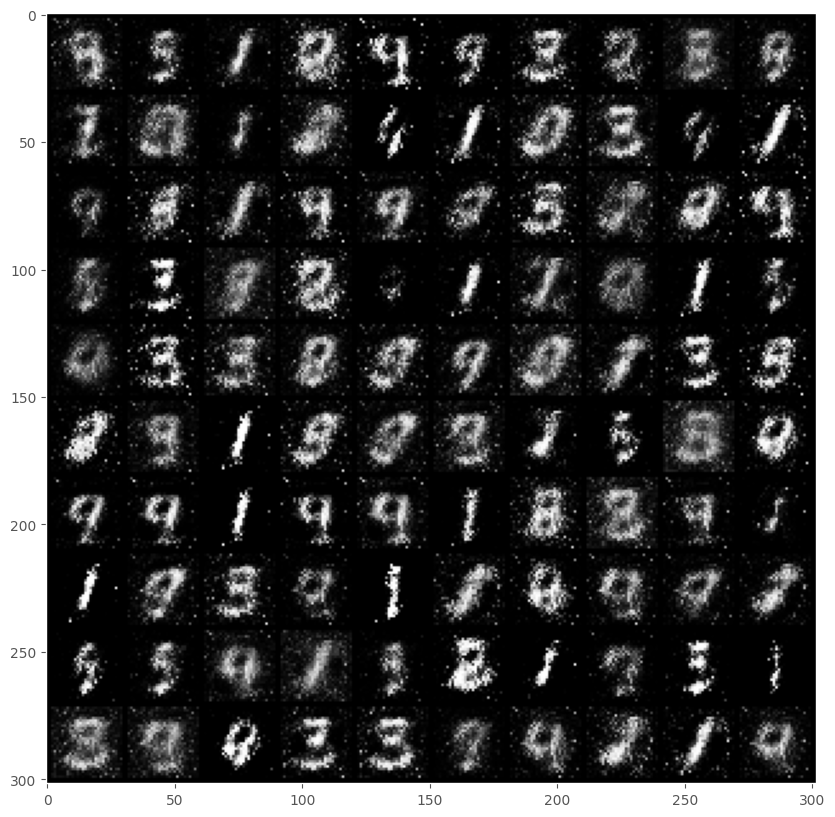

 17%|█▋        | 50/300 [20:08<1:36:59, 23.28s/it, Epoch=50/300, Step=600/600, D_Loss=0.5591, G_Loss=1.9691, D(x)=0.67, D(G(z))=0.30]

Saving fake_images-0051.png


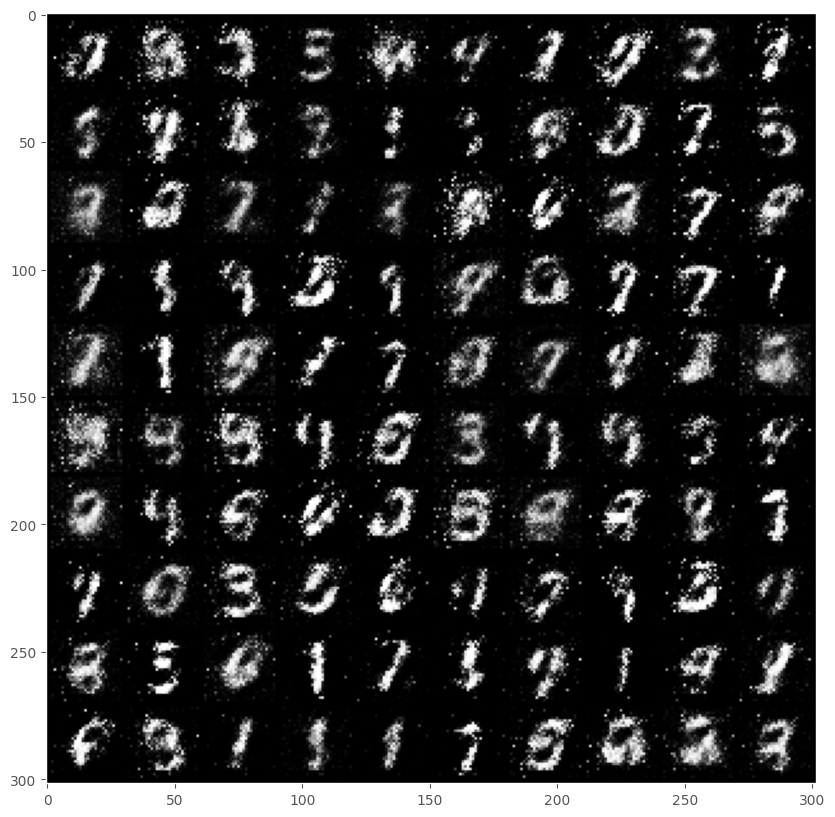

 20%|██        | 60/300 [24:03<1:33:40, 23.42s/it, Epoch=60/300, Step=600/600, D_Loss=0.4955, G_Loss=1.8966, D(x)=0.76, D(G(z))=0.35]

Saving fake_images-0061.png


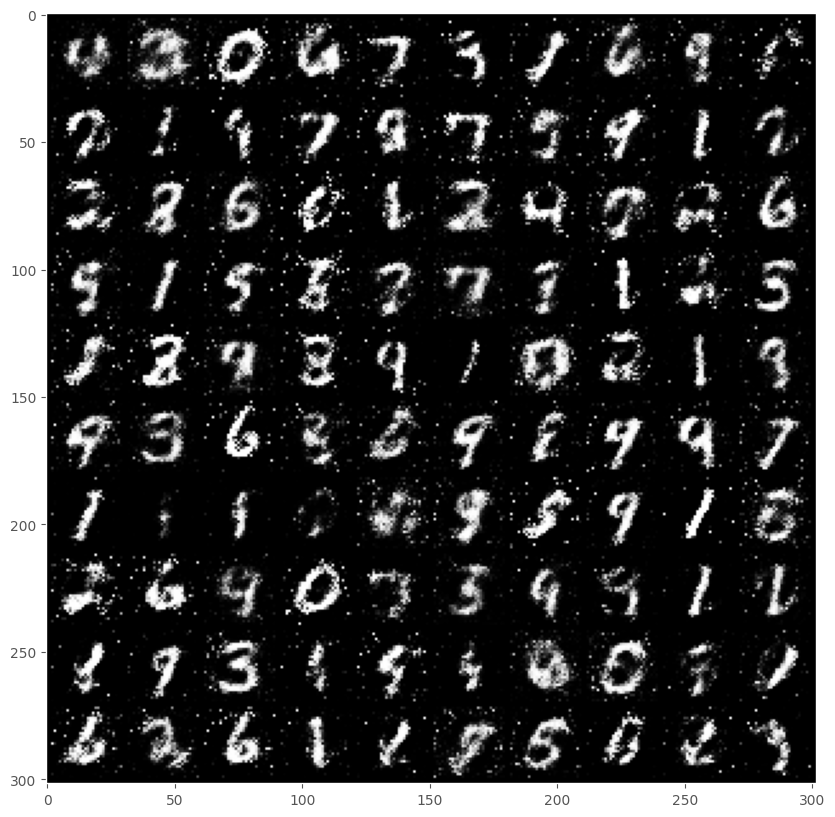

 23%|██▎       | 70/300 [27:55<1:28:36, 23.11s/it, Epoch=70/300, Step=600/600, D_Loss=0.4249, G_Loss=2.1134, D(x)=0.71, D(G(z))=0.25]

Saving fake_images-0071.png


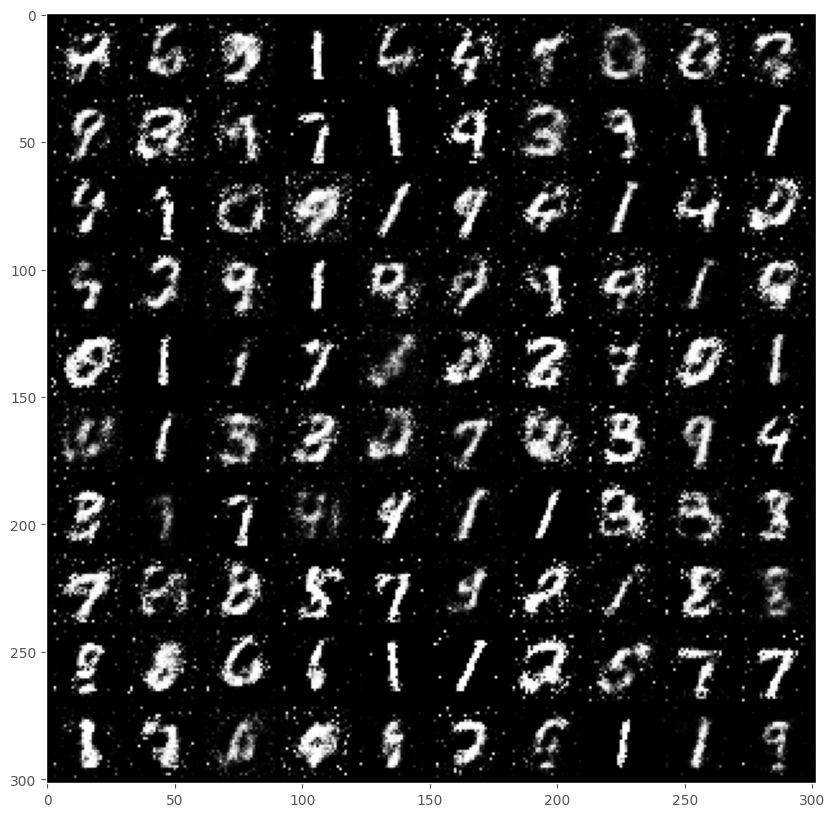

 27%|██▋       | 80/300 [31:46<1:24:10, 22.96s/it, Epoch=80/300, Step=600/600, D_Loss=0.4232, G_Loss=1.6123, D(x)=0.71, D(G(z))=0.25]

Saving fake_images-0081.png


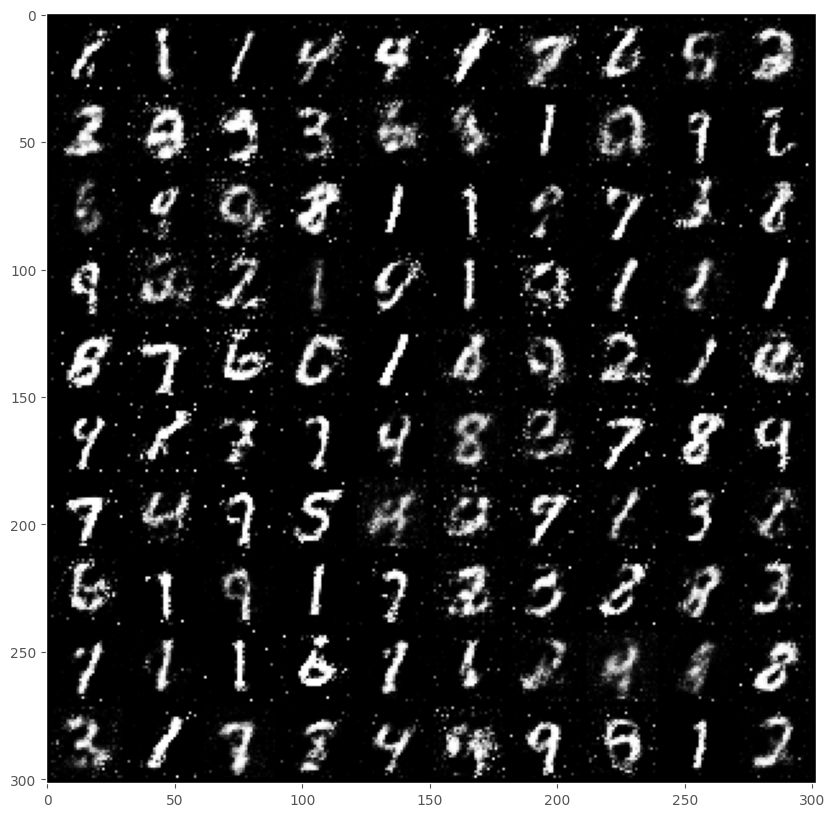

 30%|███       | 90/300 [35:36<1:20:05, 22.88s/it, Epoch=90/300, Step=600/600, D_Loss=0.4761, G_Loss=1.4161, D(x)=0.74, D(G(z))=0.34]

Saving fake_images-0091.png


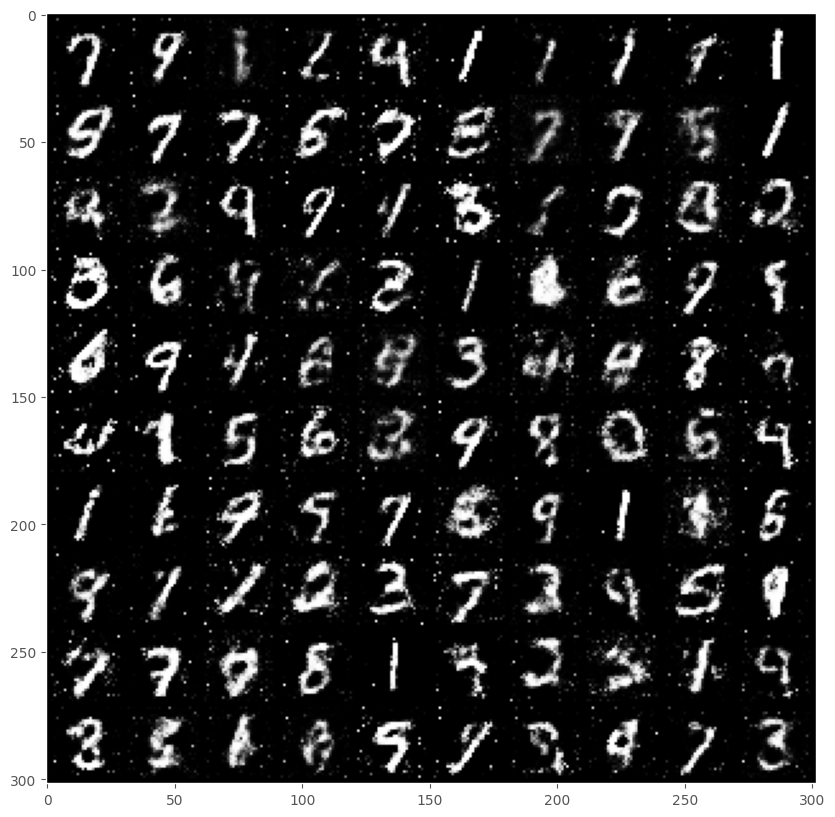

 33%|███▎      | 100/300 [39:25<1:16:16, 22.88s/it, Epoch=100/300, Step=600/600, D_Loss=0.3879, G_Loss=1.7301, D(x)=0.73, D(G(z))=0.27]

Saving fake_images-0101.png


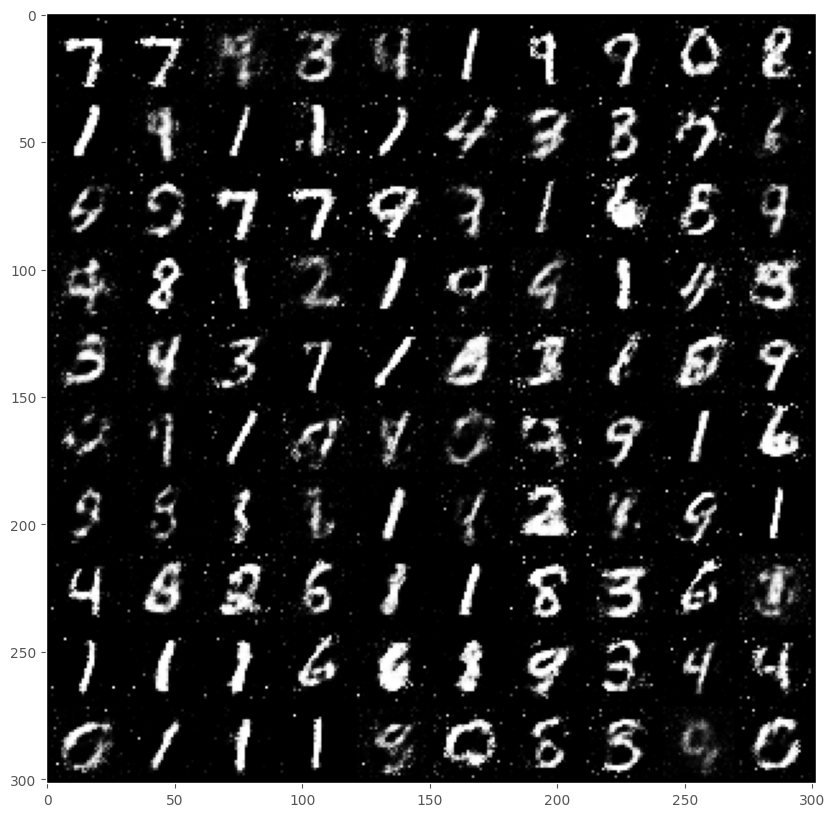

 37%|███▋      | 110/300 [43:17<1:13:26, 23.19s/it, Epoch=110/300, Step=600/600, D_Loss=0.5517, G_Loss=1.3773, D(x)=0.66, D(G(z))=0.33]

Saving fake_images-0111.png


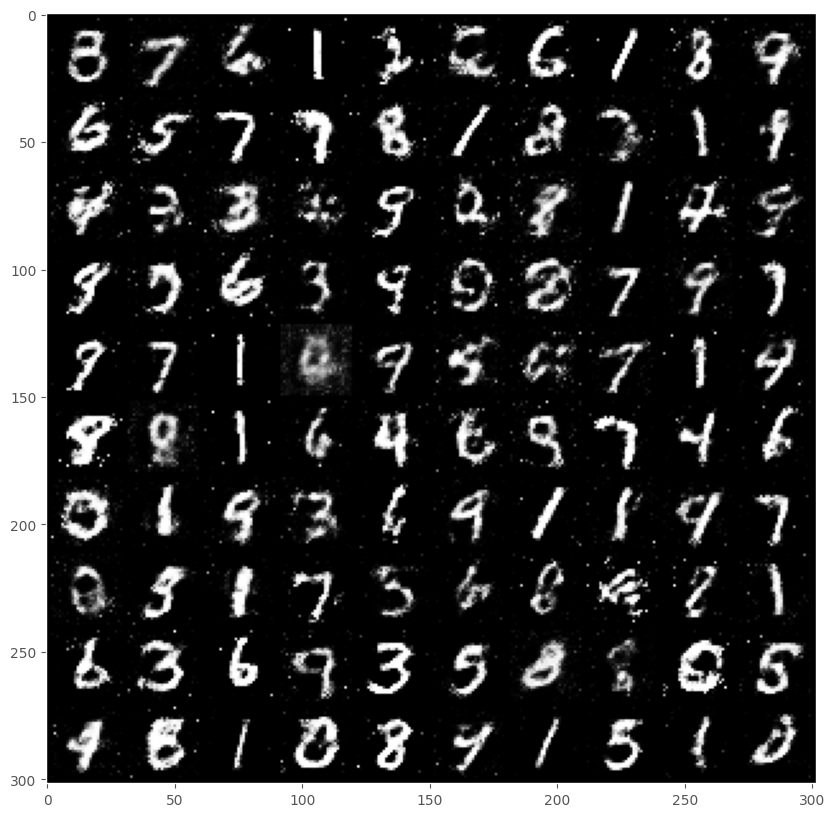

 40%|████      | 120/300 [47:11<1:09:49, 23.28s/it, Epoch=120/300, Step=600/600, D_Loss=0.5544, G_Loss=1.5201, D(x)=0.63, D(G(z))=0.34]

Saving fake_images-0121.png


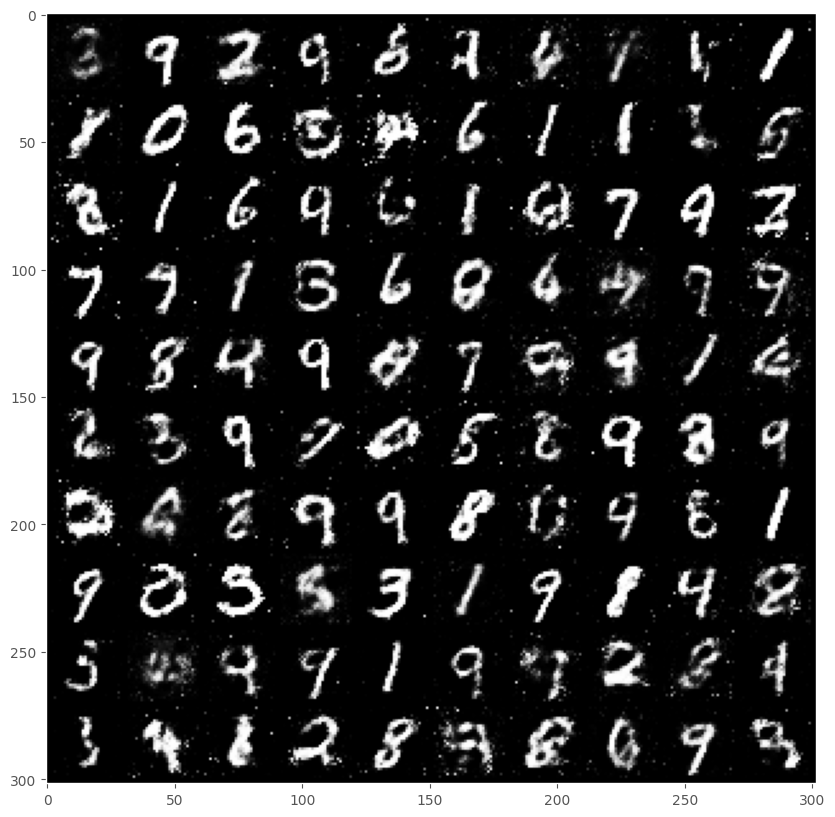

 43%|████▎     | 130/300 [51:03<1:05:55, 23.27s/it, Epoch=130/300, Step=600/600, D_Loss=0.5697, G_Loss=1.4224, D(x)=0.62, D(G(z))=0.37]

Saving fake_images-0131.png


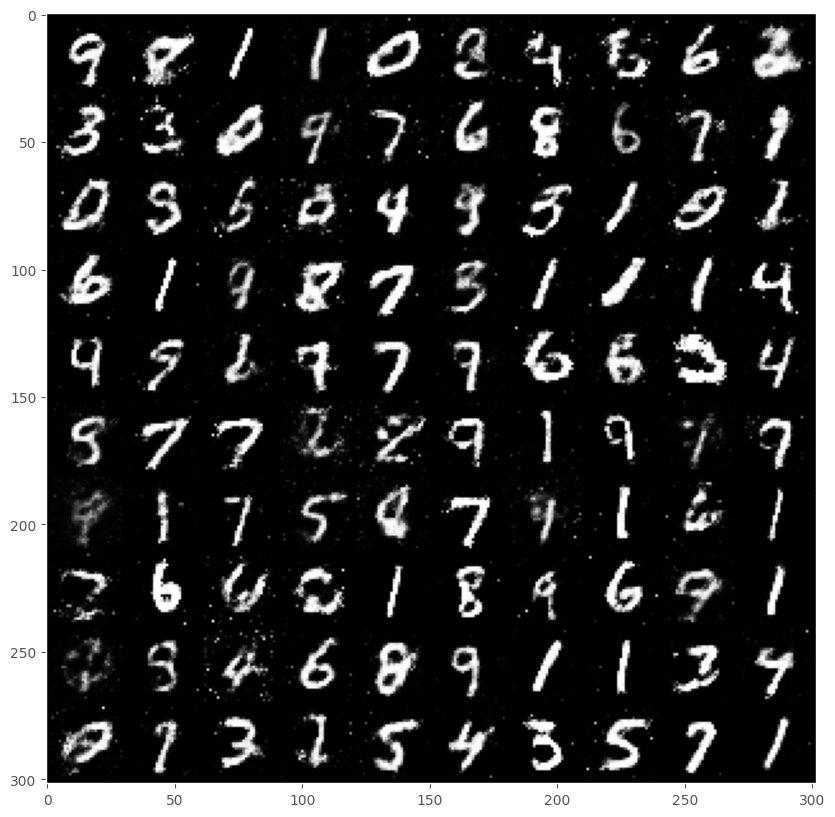

 47%|████▋     | 140/300 [54:55<1:02:00, 23.25s/it, Epoch=140/300, Step=600/600, D_Loss=0.5945, G_Loss=1.2054, D(x)=0.59, D(G(z))=0.35]

Saving fake_images-0141.png


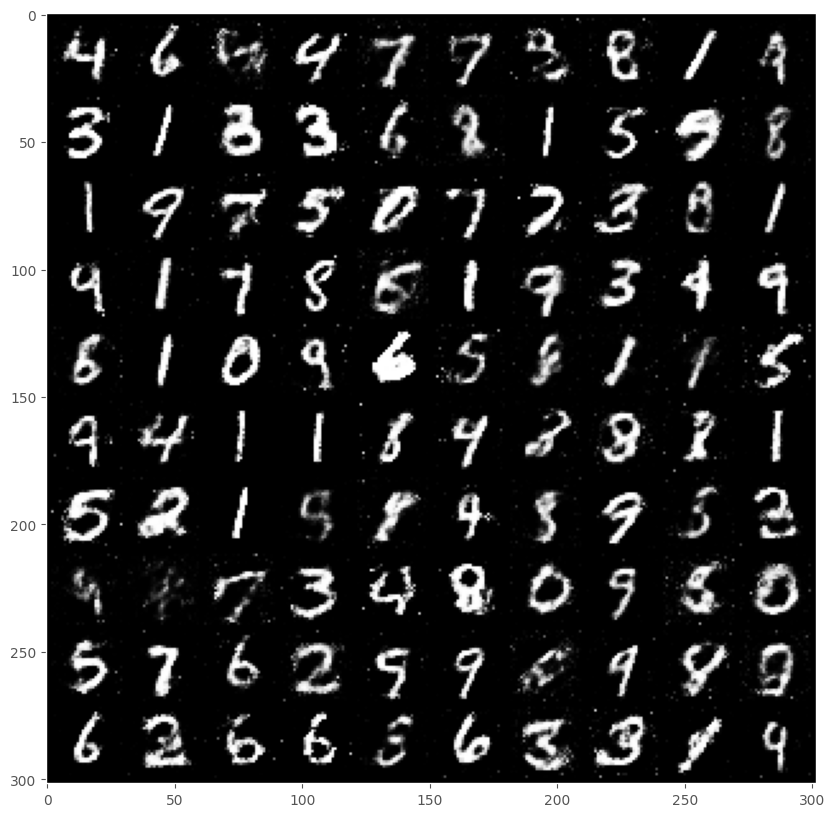

 50%|█████     | 150/300 [58:47<57:38, 23.05s/it, Epoch=150/300, Step=600/600, D_Loss=0.3805, G_Loss=1.4520, D(x)=0.75, D(G(z))=0.29]  

Saving fake_images-0151.png


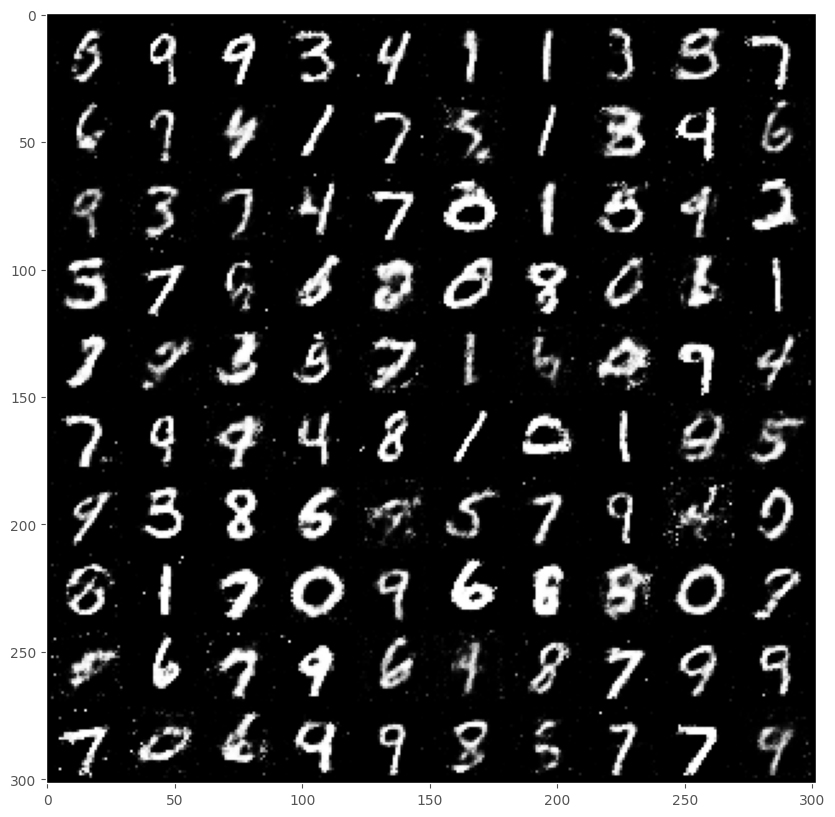

 53%|█████▎    | 160/300 [1:02:39<53:56, 23.12s/it, Epoch=160/300, Step=600/600, D_Loss=0.5091, G_Loss=1.3452, D(x)=0.65, D(G(z))=0.33]

Saving fake_images-0161.png


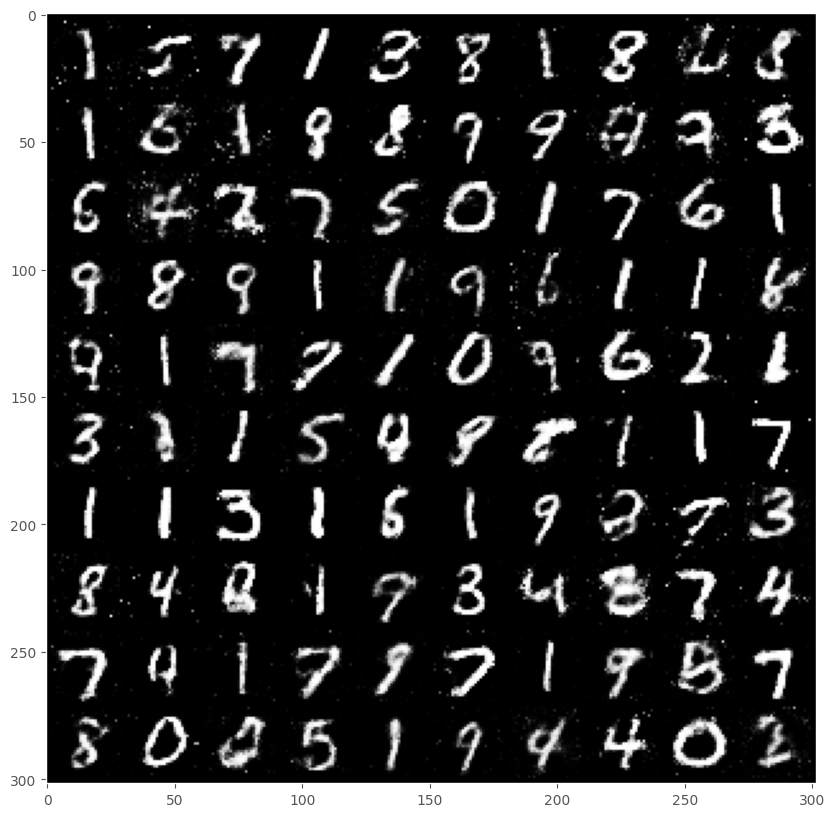

 57%|█████▋    | 170/300 [1:06:32<50:21, 23.24s/it, Epoch=170/300, Step=600/600, D_Loss=0.5596, G_Loss=1.2665, D(x)=0.69, D(G(z))=0.39]

Saving fake_images-0171.png


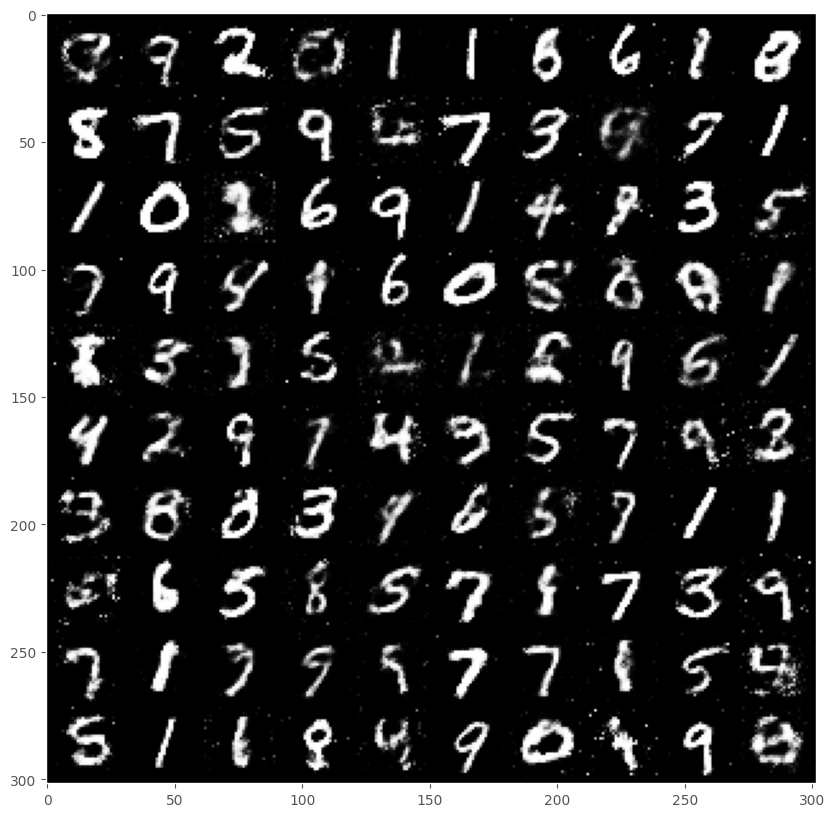

 60%|██████    | 180/300 [1:10:23<46:19, 23.16s/it, Epoch=180/300, Step=600/600, D_Loss=0.5192, G_Loss=1.2164, D(x)=0.65, D(G(z))=0.34]

Saving fake_images-0181.png


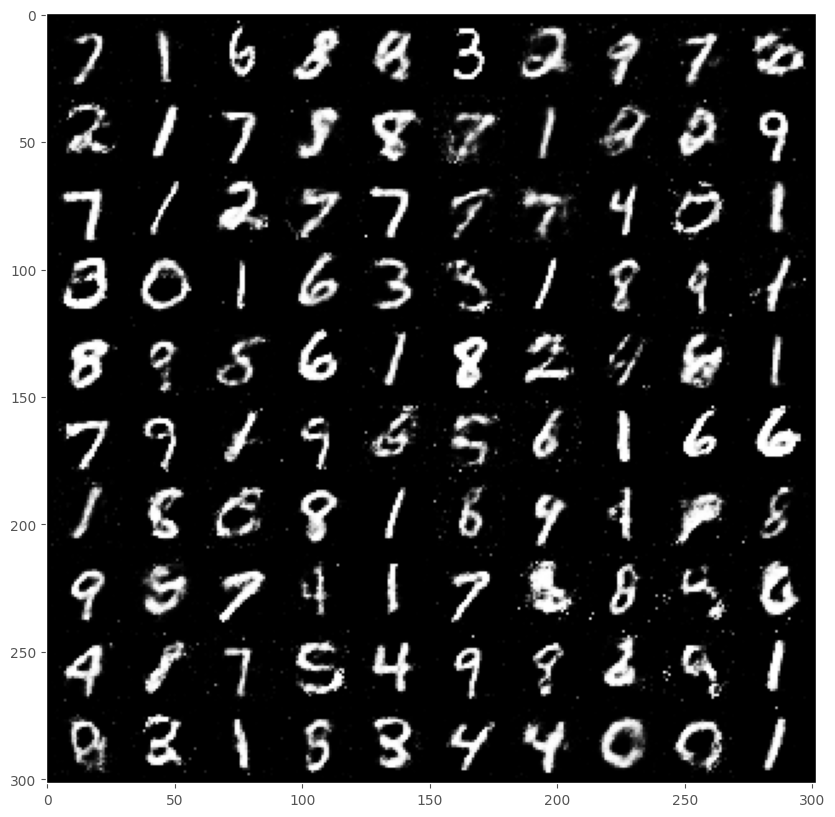

 61%|██████    | 182/300 [1:10:57<46:00, 23.39s/it, Epoch=182/300, Step=200/600, D_Loss=0.5849, G_Loss=1.2631, D(x)=0.65, D(G(z))=0.41]


KeyboardInterrupt: 

In [66]:
%%time
total_step = len(data_loader)
d_losses, g_losses, real_scores, fake_scores = [], [], [], []

G.to(device)
D.to(device)

cur_tqdm = tqdm(range(num_epochs), position=0, leave=True)

for epoch in cur_tqdm:
    for i, (images, _) in enumerate(data_loader):
        # Load a batch & transform to vectors
        images = images.reshape(batch_size, -1).to(device)
        
        # Train the discriminator
        d_loss, real_score, fake_score = train_discriminator(D, G, images)

        # Train the generator
        g_loss, fake_images = train_generator(G, D)

        # Inspect the losses
        if (i + 1) % 200 == 0:
            d_losses.append(d_loss.item())
            g_losses.append(g_loss.item())
            real_scores.append(real_score.mean().item())
            fake_scores.append(fake_score.mean().item())
            
            show_dict = {'Epoch': f'{epoch}/{num_epochs}',
                         'Step': f'{i + 1}/{total_step}',
                         'D_Loss': f'{d_loss.item():.4f}',
                         'G_Loss': f'{g_loss.item():.4f}',
                         'D(x)': f'{real_score.mean().item():.2f}',
                         'D(G(z))': f'{fake_score.mean().item():.2f}'}
            cur_tqdm.set_postfix(show_dict)
            
    # Sample and save images
    # visualize frequently mode collapse control
    if epoch % 10 == 0:
        save_fake_images_mnist(G, epoch + 1, show_image=True)

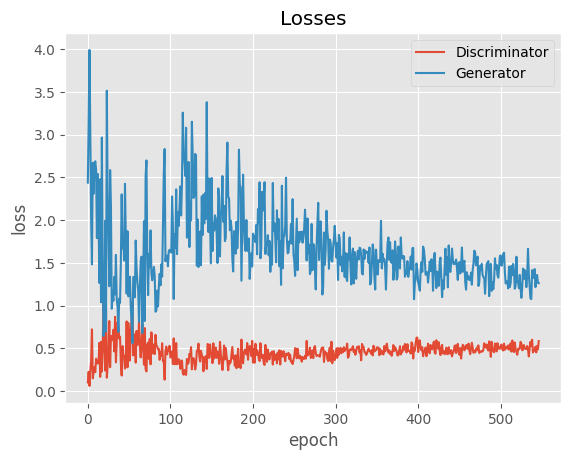

In [67]:
# show the discrimator loss and generator loss
plt.plot(d_losses, "-")
plt.plot(g_losses, "-")
plt.xlabel("epoch")
plt.ylabel("loss")
plt.legend(["Discriminator", "Generator"])
plt.title("Losses");

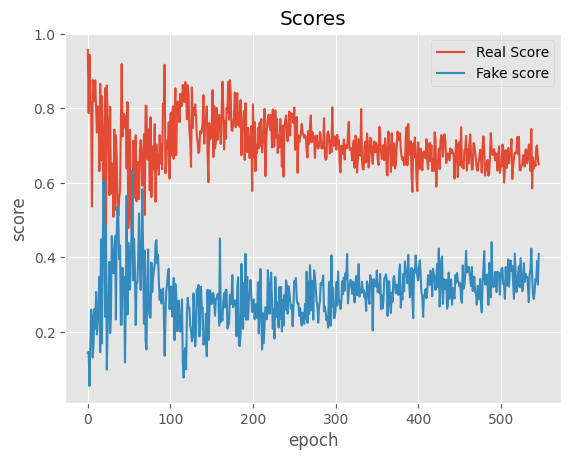

In [68]:
# plot the accuracy of discrimator
plt.plot(real_scores, "-")
plt.plot(fake_scores, "-")
plt.xlabel("epoch")
plt.ylabel("score")
plt.legend(["Real Score", "Fake score"])
plt.title("Scores");

In [69]:
torch.save(G, 'gan-G-4.pth')

In [70]:
torch.save(D, 'gan-D-4.pth')

In [ ]:
D = torch.load('/kaggle/input/1_gan_dcgan-1/pytorch/default/2/gan-D-2.pth', weights_only=False, map_location=torch.device(device))

In [ ]:
G = torch.load('/kaggle/input/1_gan_dcgan-1/pytorch/default/2/gan-G-2.pth', weights_only=False, map_location=torch.device(device))

In [ ]:
!zip -r images.zip /kaggle/working/images

In [ ]:
import torch.nn as nn
from collections import OrderedDict


class LeNet5(nn.Module):
    """
    Input - 1x32x32
    C1 - 6@28x28 (5x5 kernel)
    tanh
    S2 - 6@14x14 (2x2 kernel, stride 2) Subsampling
    C3 - 16@10x10 (5x5 kernel, complicated shit)
    tanh
    S4 - 16@5x5 (2x2 kernel, stride 2) Subsampling
    C5 - 120@1x1 (5x5 kernel)
    F6 - 84
    tanh
    F7 - 10 (Output)
    """
    def __init__(self):
        super(LeNet5, self).__init__()

        self.convnet = nn.Sequential(OrderedDict([
            ('c1', nn.Conv2d(1, 6, kernel_size=(5, 5))),
            ('relu1', nn.ReLU()),
            ('s2', nn.MaxPool2d(kernel_size=(2, 2), stride=2)),
            ('c3', nn.Conv2d(6, 16, kernel_size=(5, 5))),
            ('relu3', nn.ReLU()),
            ('s4', nn.MaxPool2d(kernel_size=(2, 2), stride=2)),
            ('c5', nn.Conv2d(16, 120, kernel_size=(5, 5))),
            ('relu5', nn.ReLU())
        ]))

        self.fc = nn.Sequential(OrderedDict([
            ('f6', nn.Linear(120, 84)),
            ('relu6', nn.ReLU()),
            ('f7', nn.Linear(84, 10)),
            ('sig7', nn.LogSoftmax(dim=-1))
        ]))

    def forward(self, img):
        output = self.convnet(img)
        output = output.view(img.size(0), -1)
        output = self.fc(output)
        return output

In [ ]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
net = LeNet5().eval()
net.load_state_dict(torch.load('/kaggle/input/1_gan_dcgan-1/pytorch/default/2/lenet_epoch12_test_acc0.991.pth', weights_only=False))
net = net.to(device)

In [ ]:
count = 100
index = 1

sample_vectors = torch.Tensor(np.random.normal(0, 1, (count, latent_size))).to(device)
fake_images = G(sample_vectors)
fake_images = fake_images.reshape(fake_images.size(0), 1, 28, 28)
fake_fname = "fake_images-{0:0=4d}.png".format(index)

path = os.path.join(sample_dir, fake_fname)
save_image(denorm(fake_images), path, nrow=10)

plt.figure(figsize=(10, 10))
plt.grid(False)
plt.imshow(np.asarray(Image.open(path)))
plt.show()

In [ ]:
fake_images.shape

In [ ]:
 transform=transforms.Compose([transforms.Resize((32, 32))])
    
fake_images = transform(fake_images)
fake_images.shape

In [ ]:
preds = net(fake_images).cpu().detach().numpy()
class_preds = np.argmax(preds, axis=1)
class_preds

## 2. DCGAN

*Source: <a href="https://arxiv.org/pdf/1511.06434v2.pdf" target="_blank">Radford, Alec, Luke Metz, and Soumith Chintala. "Unsupervised representation learning with deep convolutional generative adversarial networks." arXiv preprint arXiv:1511.06434 (2015)</a>.*

The goal of this part is to enhance your results achieved in the part one with DCGAN. Feel free to reuse your code, improve architecture or training scheme, etc.

In [2]:
class CFG:
    batch_size = 128
    num_epochs = 30
    workers = 2
    seed = 42
    image_size = 64
    download = True
    dataroot = "data-cifar"
    nc = 3  ## number of chanels
    ngf = 64  # Size of feature maps in generator
    nz = 100  # latent random input vector
    ndf = 64  # Size of feature maps in discriminator
    lr = 0.0002
    sample_dir = "./images-cifar/"
    
ngpu = torch.cuda.device_count()

if not os.path.exists(CFG.sample_dir):
    os.makedirs(CFG.sample_dir)

cifar_dataset = CIFAR10(
    root=CFG.dataroot,
    download=CFG.download,
    transform=transforms.Compose(
        [
            transforms.Resize([CFG.image_size, CFG.image_size]),
            transforms.ToTensor(),
            transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
        ]
    ),
)

100%|██████████| 170498071/170498071 [00:04<00:00, 42472737.33it/s]


Extracting data-cifar/cifar-10-python.tar.gz to data-cifar


In [3]:
random.seed(CFG.seed)       # python random seed
torch.manual_seed(CFG.seed) # pytorch random seed
np.random.seed(CFG.seed) # numpy random seed
torch.backends.cudnn.deterministic = True

In [4]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

Label:  6


(array([ 3.,  6., 52., 36.,  6.,  4., 12., 40., 40.,  7.,  2.,  6., 22.,
        32., 32.]),
 array([-0.87450981, -0.81124181, -0.74797386, -0.68470585, -0.62143791,
        -0.5581699 , -0.49490196, -0.43163398, -0.36836597, -0.305098  ,
        -0.24183004, -0.17856206, -0.11529408, -0.0520261 ,  0.01124188,
         0.07450986]),
 <BarContainer object of 15 artists>)

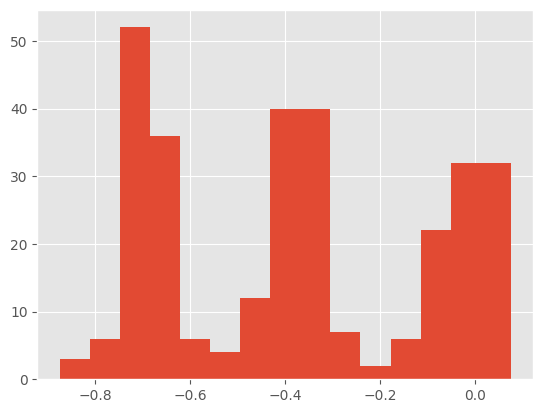

In [5]:
img, label = cifar_dataset[0]
print("Label: ", label)
plt.hist(img[:, 5:15, 5:15].flatten(), bins=15)

In [6]:
# unnormalization image from range (-1)-1 to range 0-1 to display it
def denorm(x):
    x_min = x.min()
    x_max = x.max()
    x = (x - x_min) / (x_max - x_min)
    return x

img.shape=torch.Size([3, 64, 64])


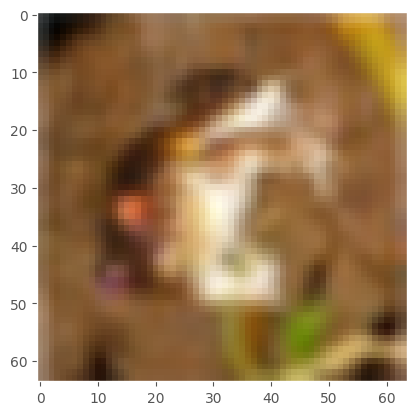

In [7]:
# show image sample with matplotlib
print(f"{img.shape=}")

plt.grid(False)
plt.imshow(denorm(img.transpose(0, -1)))
plt.show()

(array([ 3.,  6., 52., 36.,  6.,  4., 12., 40., 40.,  7.,  2.,  6., 22.,
        32., 32.]),
 array([0.05976095, 0.09189907, 0.12403718, 0.1561753 , 0.18831341,
        0.22045153, 0.25258964, 0.28472775, 0.31686589, 0.349004  ,
        0.38114211, 0.41328022, 0.44541833, 0.47755647, 0.50969458,
        0.54183269]),
 <BarContainer object of 15 artists>)

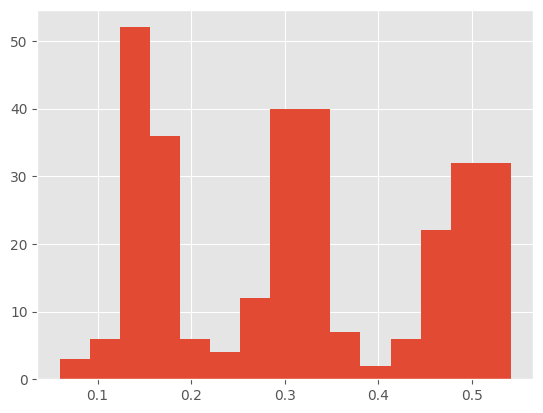

In [8]:
plt.hist(denorm(img)[:, 5:15, 5:15].flatten(), bins=15)

In [9]:
# create the dataloader
from torch.utils.data import DataLoader

data_loader = DataLoader(cifar_dataset, batch_size=CFG.batch_size, shuffle=True, num_workers=CFG.workers, drop_last=True)

### DCGAN implementation

In [10]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [11]:
"""
input_size = (output_size - 1) * stride_size - 2 * padding_size + kernel_size 

kernel_size=4, stride=1, padding=0
input_size = (output_size - 1) + 4 
           = output_size + 3

kernel_size=4, stride=2, padding=1
input_size = (output_size - 1) * 2 - 2 + 4 
           = 2 * output_size
           
torch.nn.ConvTranspose2d(
    in_channels, 
    out_channels,
    kernel_size, 
    stride=1, 
    padding=0, output_padding=0, groups=1, bias=True, dilation=1, padding_mode='zeros', device=None, dtype=None)
"""
class DCGenerator(nn.Module):
    def __init__(self, nc, nz, ngf):
        # ConvTranspose2d - BatchNorm - Relu 
        # - ConvTranspose2d - BatchNorm - Relu 
        # - ConvTranspose2d - BatchNorm - Relu
        # - ConvTranspose2d - BatchNorm - Relu 
        # - ConvTranspose2d - Tanh
        
        super(DCGenerator, self).__init__()
        self.blocks = nn.Sequential(
            # ngf = 64 
            # Input: N * z_dim * 1 * 1
            self._block(nz, ngf * 16, kernel_size=4, stride=1, padding=0),
            # N * (ngf * 16) * 4 * 4
            self._block(ngf * 16, ngf * 8, kernel_size=4, stride=2, padding=1),
            # N * (ngf * 8) * 8 * 8
            self._block(ngf * 8, ngf * 4, kernel_size=4, stride=2, padding=1),
            # N * (ngf * 4) * 16 * 16
            self._block(ngf * 4, ngf * 2, kernel_size=4, stride=2, padding=1),
            # N * (ngf * 2) * 32 * 32
            nn.ConvTranspose2d(ngf * 2, nc, kernel_size=4, stride=2, padding=1, bias=False),
            # N * nc * 64 * 64
        )
        
    def _block(self, in_channels, out_channels, kernel_size, stride, padding):
        return nn.Sequential(
            nn.ConvTranspose2d(in_channels, out_channels, kernel_size, stride, padding, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(True),
        )

    def forward(self, x):
        x = self.blocks(x)
        return F.tanh(x)


"""
output_size = (input_size + 2 * padding_size - kernel_size) // stride_size + 1

kernel_size=4, stride=1, padding=0
output_size = input_size - 3

kernel_size=4, stride=2, padding=1
output_size = (input_size + 2 - 4) // 2 + 1
            = (input_size - 2) // 2 + 1
            = input_size // 2 - 1 + 1
            = input_size // 2
"""
class DCDiscriminator(nn.Module):
    def __init__(self, nc, ndf):
        # conv2d - leaky - conv2d - batchnorm - leaky - conv2d - batchnorm - leaky - conv - batchnorm - leaky - conv2d
        super(DCDiscriminator, self).__init__()
        self.blocks = nn.Sequential(
            # Input: N * nc * 64 * 64
            nn.Conv2d(nc, ndf, 3, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # N * ndf * 32 * 32
            self._block(ndf, ndf * 2, kernel_size=4, stride=2, padding=1),
            # N * (ngf * 2) * 16 * 16
            self._block(ndf * 2, ndf * 4, kernel_size=4, stride=2, padding=1),
            # N * (ngf * 4) * 8 * 8
            self._block(ndf * 4, ndf * 8, kernel_size=4, stride=2, padding=1),
            # N * (ngf * 8) * 4 * 4
            nn.Conv2d(ndf * 8, out_channels=1, kernel_size=4, stride=1, padding=0, bias=False),
            # N * 1 * 1 * 1 = N
        )
        
    def _block(self, in_channels, out_channels, kernel_size, stride, padding):
        return nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size, stride, padding, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.LeakyReLU(0.2, inplace=True),
        )

    def forward(self, x):
        x = self.blocks(x)
        return F.sigmoid(x)

In [12]:
# Create the generator
DCG =  DCGenerator(CFG.nc, CFG.nz, CFG.ngf).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    DCG = nn.DataParallel(DCG, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights to mean=0, stdev=0.2.
DCG.apply(weights_init)

DataParallel(
  (module): DCGenerator(
    (blocks): Sequential(
      (0): Sequential(
        (0): ConvTranspose2d(100, 1024, kernel_size=(4, 4), stride=(1, 1), bias=False)
        (1): BatchNorm2d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): ReLU(inplace=True)
      )
      (1): Sequential(
        (0): ConvTranspose2d(1024, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
        (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): ReLU(inplace=True)
      )
      (2): Sequential(
        (0): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
        (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): ReLU(inplace=True)
      )
      (3): Sequential(
        (0): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
        (1): BatchNorm2d(128, eps=1e-05, momen

In [13]:
# Create the Discriminator
DCD = DCDiscriminator(CFG.nc, CFG.ndf).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    DCD = nn.DataParallel(DCD, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights to mean=0, stdev=0.2.
DCD.apply(weights_init)

DataParallel(
  (module): DCDiscriminator(
    (blocks): Sequential(
      (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
      (1): LeakyReLU(negative_slope=0.2, inplace=True)
      (2): Sequential(
        (0): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
        (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): LeakyReLU(negative_slope=0.2, inplace=True)
      )
      (3): Sequential(
        (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
        (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): LeakyReLU(negative_slope=0.2, inplace=True)
      )
      (4): Sequential(
        (0): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
        (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): LeakyReLU(negati

In [14]:
# show the output of model
z = torch.randn(2, CFG.nz, 1, 1).to(device)
print(f"{z.shape=}")
y = DCG(z)
print(f"{y.shape}")

z.shape=torch.Size([2, 100, 1, 1])


/opt/conda/lib/python3.10/site-packages/torch/nn/parallel/parallel_apply.py:79: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.device(device), torch.cuda.stream(stream), autocast(enabled=autocast_enabled):


torch.Size([2, 3, 64, 64])


In [15]:
# define the criterion is nn.BCELoss()
criterion = nn.BCELoss()

# Define the optimizer for generator and discrimator
DCG_optimizer = torch.optim.Adam(DCG.parameters(), lr=CFG.lr, betas=(0.5, 0.999))
DCD_optimizer = torch.optim.Adam(DCD.parameters(), lr=CFG.lr, betas=(0.5, 0.999))

In [16]:
def reset_grad():
    ## reset gradient for optimizer of generator and discrimator
    DCG_optimizer.zero_grad()
    DCD_optimizer.zero_grad()

def train_discriminator(D_model, G_model, images):
    # Create the labels which are later used as input for the BCE loss
    real_labels = torch.ones(CFG.batch_size).to(device)
    fake_labels = torch.zeros(CFG.batch_size).to(device)

    outputs = D_model(images)
    
    # Loss for real images
    real_score = outputs.view(-1)
    real_loss = criterion(real_score, real_labels)

    # Loss for fake images
    z = torch.randn(CFG.batch_size, CFG.nz, 1, 1).to(device)
    
    fake_images = G_model(z)
    outputs = D_model(fake_images.detach())
    
    fake_score = outputs.view(-1)
    fake_loss = criterion(fake_score, fake_labels)

    # Sum losses
    d_loss = (real_loss + fake_loss) / 2

    # Reset gradients
    reset_grad()

    # Compute gradients
    d_loss.backward()

    # Adjust the parameters using backprop
    DCD_optimizer.step()
    
    return d_loss, real_score, fake_score

In [17]:
def train_generator(G_model, D_model):
    # Generate fake images and calculate loss
    z = torch.randn(CFG.batch_size, CFG.nz, 1, 1).to(device)
    labels = torch.ones(CFG.batch_size).to(device)
    
    fake_images = G_model(z)
    score = D_model(fake_images).view(-1)
    
    # calculate the generator loss
    g_loss = criterion(score, labels)

    # Reset gradients
    reset_grad()

    # Backprop and optimize
    g_loss.backward()
    
    # Adjust the parameters using backprop
    DCG_optimizer.step()

    return g_loss, fake_images

### Start the training proccess

In [21]:
def save_fake_images_cifar(DCG_model, index, show_image=False):
    sample_vectors = torch.randn(CFG.batch_size, CFG.nz, 1, 1).to(device)
    fake_images = DCG_model(sample_vectors)
    fake_images = fake_images.reshape(fake_images.size(0), 3, 64, 64)
    fake_fname = "fake_images_cifar-{0:0=4d}.png".format(index)
    print("Saving", fake_fname)
    path = os.path.join(CFG.sample_dir, fake_fname)
    save_image(denorm(fake_images), path, nrow=10)
    
    # show output after epochs training
    if show_image:
        plt.figure(figsize=(10, 10))
        plt.grid(False)
        plt.imshow(np.asarray(Image.open(path)))
        plt.show()

  0%|          | 0/30 [00:55<?, ?it/s, Epoch=0/30, Step=200/390, D_Loss=0.4292, G_Loss=5.9525, D(x)=0.95, D(G(z))=0.46]

Saving fake_images_cifar-0001.png


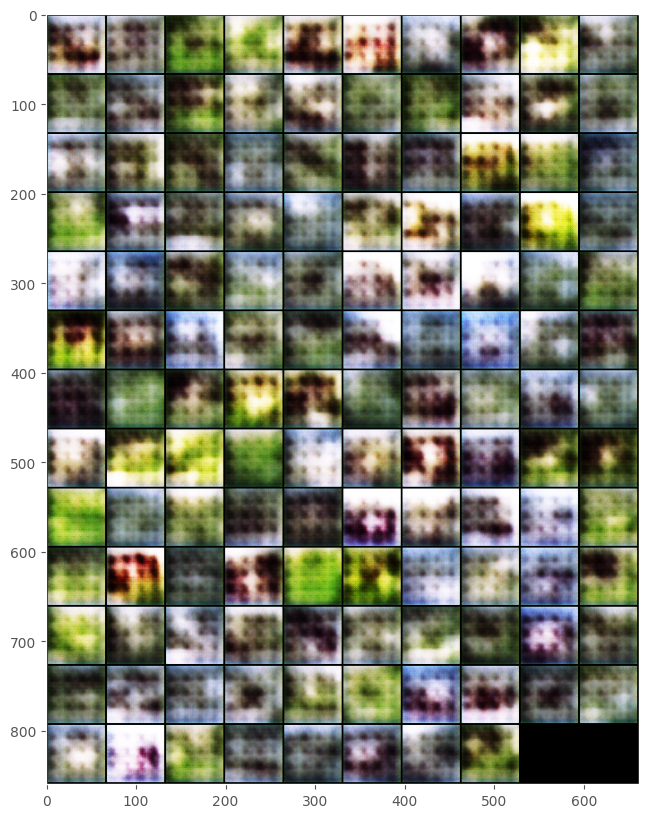

  3%|▎         | 1/30 [02:42<52:03, 107.70s/it, Epoch=1/30, Step=200/390, D_Loss=0.2570, G_Loss=3.5106, D(x)=0.80, D(G(z))=0.20]

Saving fake_images_cifar-0002.png


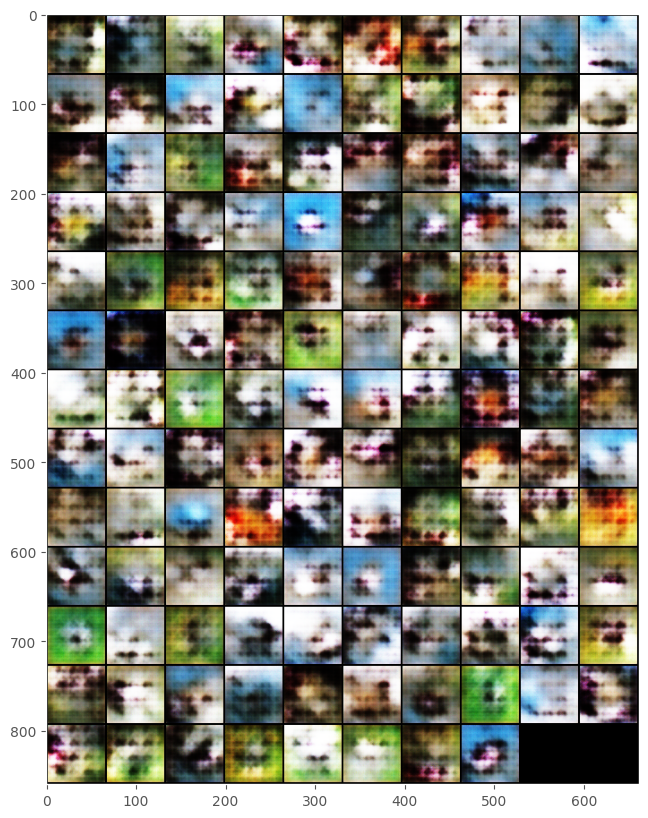

  7%|▋         | 2/30 [04:29<50:05, 107.34s/it, Epoch=2/30, Step=200/390, D_Loss=0.3991, G_Loss=4.0108, D(x)=0.83, D(G(z))=0.41]

Saving fake_images_cifar-0003.png


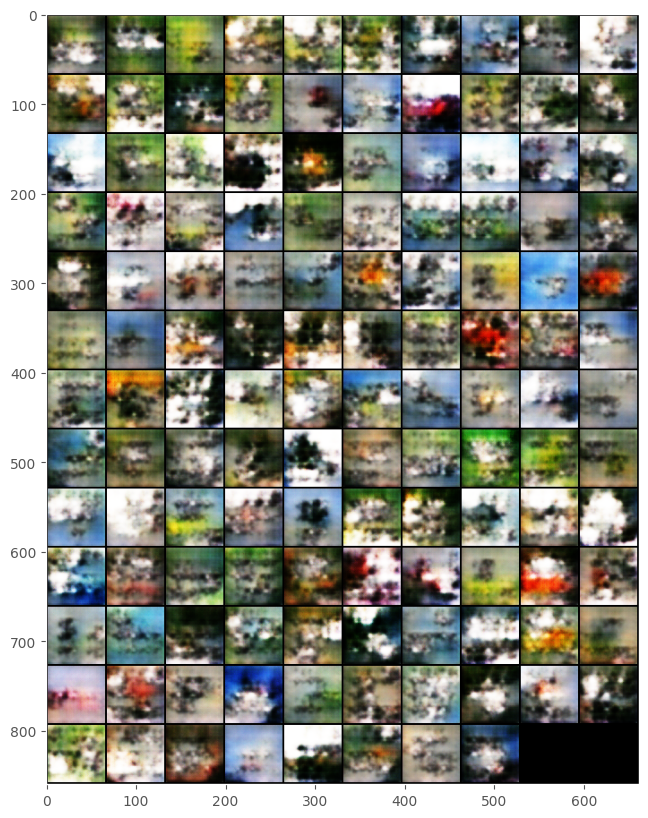

 10%|█         | 3/30 [06:16<48:13, 107.15s/it, Epoch=3/30, Step=200/390, D_Loss=0.2379, G_Loss=2.8477, D(x)=0.79, D(G(z))=0.17]

Saving fake_images_cifar-0004.png


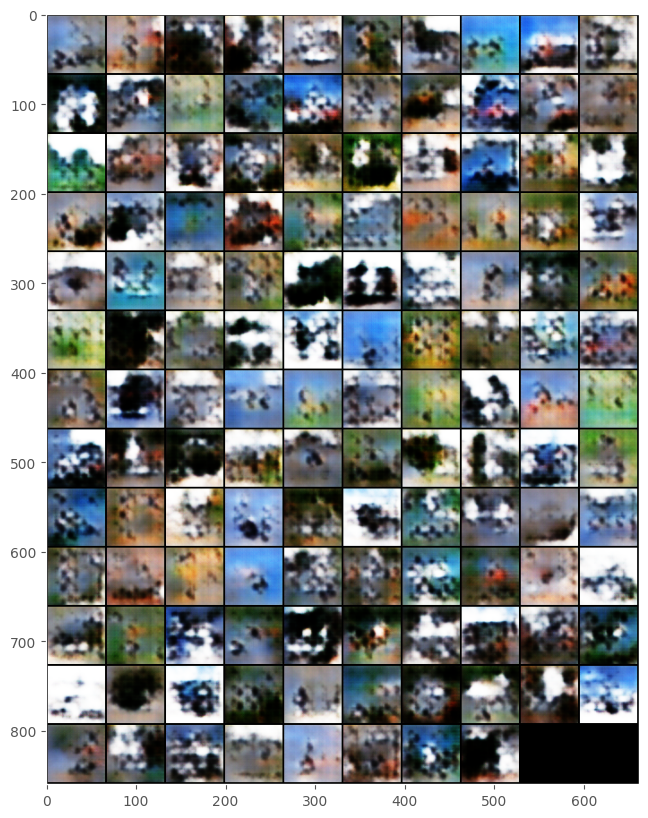

 13%|█▎        | 4/30 [08:02<46:22, 107.03s/it, Epoch=4/30, Step=200/390, D_Loss=0.3003, G_Loss=2.3333, D(x)=0.68, D(G(z))=0.12]

Saving fake_images_cifar-0005.png


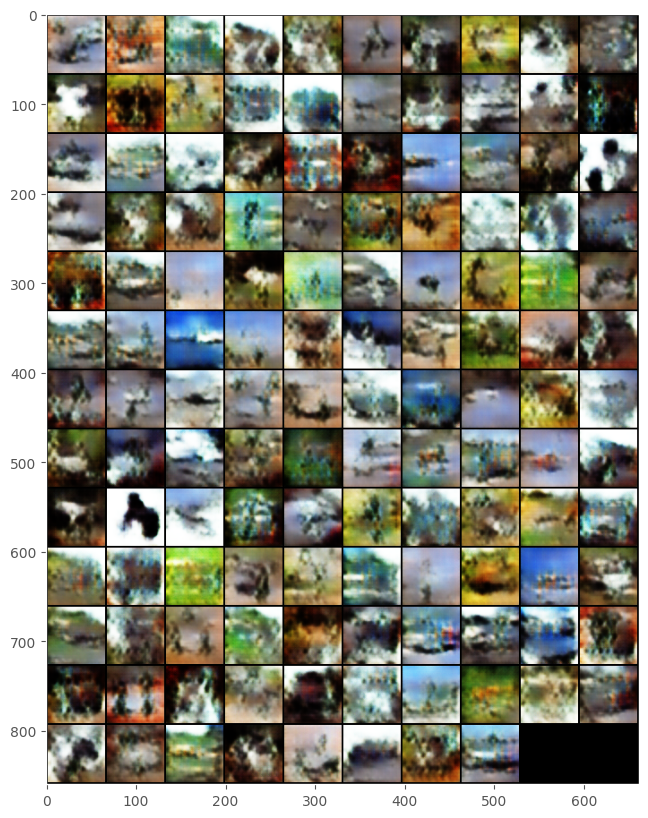

 17%|█▋        | 5/30 [09:50<44:33, 106.95s/it, Epoch=5/30, Step=200/390, D_Loss=0.7544, G_Loss=1.9533, D(x)=0.51, D(G(z))=0.45]

Saving fake_images_cifar-0006.png


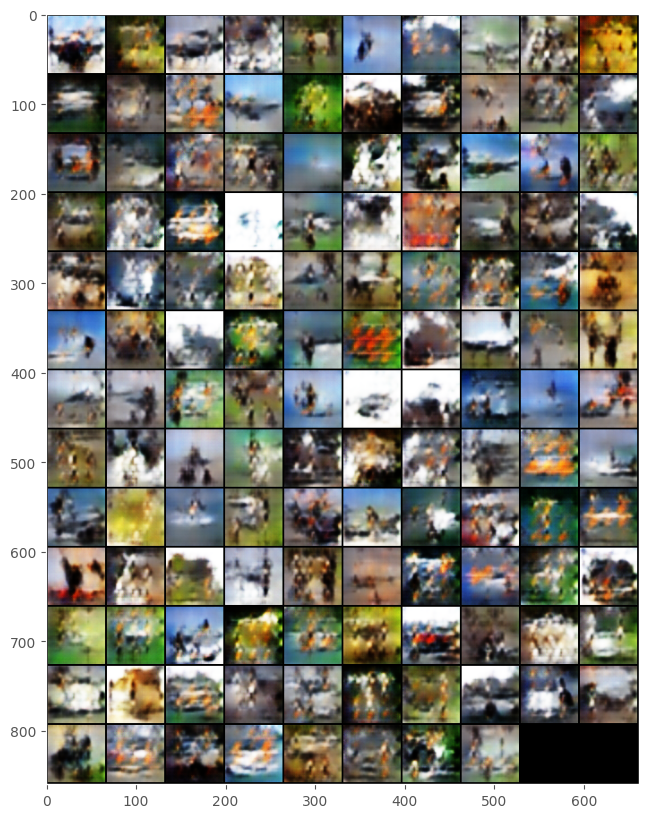

 20%|██        | 6/30 [11:37<42:50, 107.09s/it, Epoch=6/30, Step=200/390, D_Loss=0.3021, G_Loss=1.3431, D(x)=0.68, D(G(z))=0.14]

Saving fake_images_cifar-0007.png


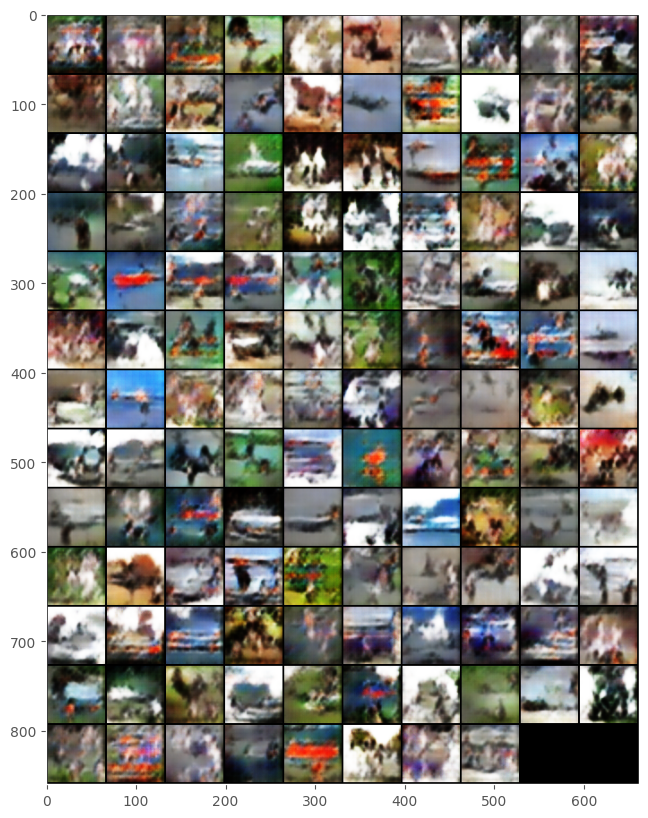

 23%|██▎       | 7/30 [13:24<41:04, 107.15s/it, Epoch=7/30, Step=200/390, D_Loss=0.2769, G_Loss=2.9168, D(x)=0.80, D(G(z))=0.26]

Saving fake_images_cifar-0008.png


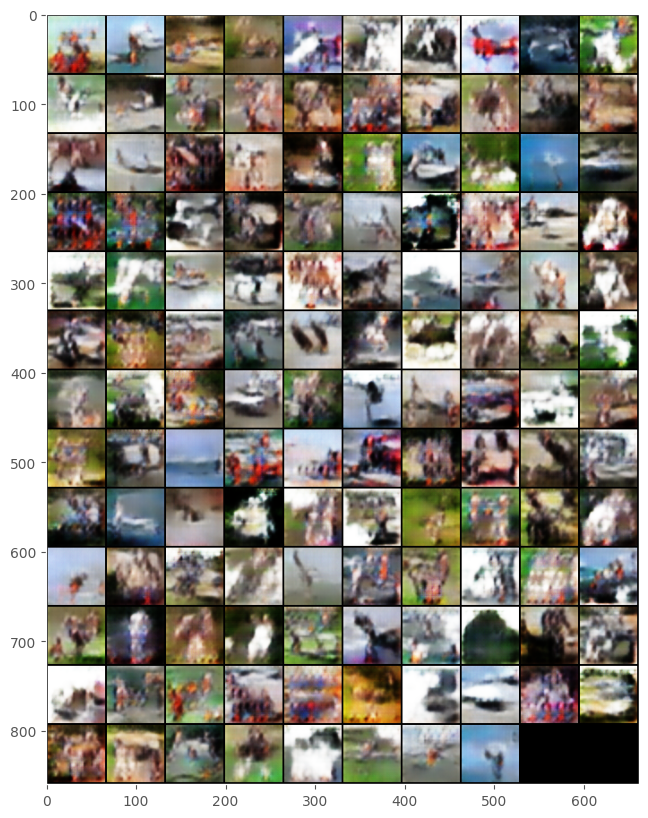

 27%|██▋       | 8/30 [15:11<39:17, 107.14s/it, Epoch=8/30, Step=200/390, D_Loss=0.3439, G_Loss=2.5899, D(x)=0.90, D(G(z))=0.41]

Saving fake_images_cifar-0009.png


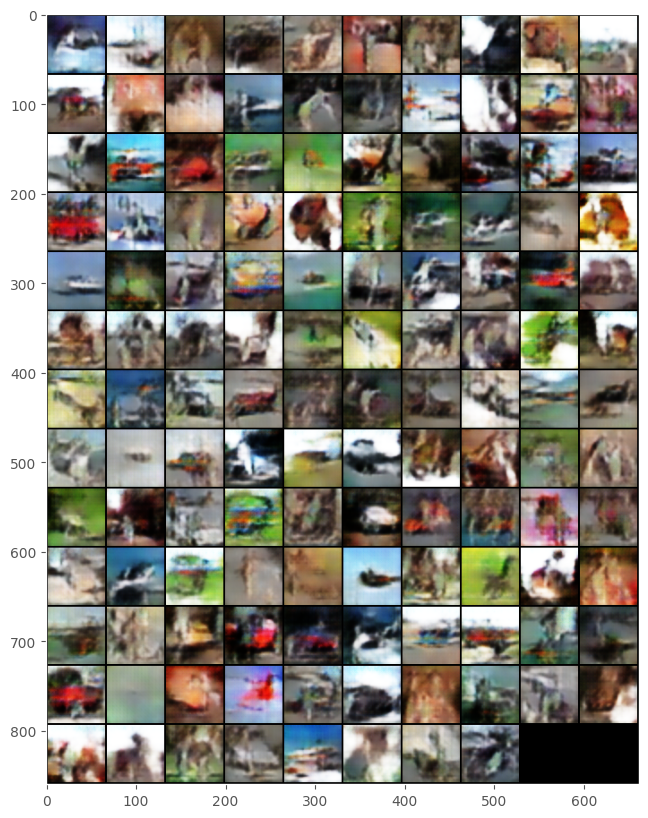

 30%|███       | 9/30 [16:58<37:29, 107.11s/it, Epoch=9/30, Step=200/390, D_Loss=0.4219, G_Loss=1.4256, D(x)=0.51, D(G(z))=0.06]

Saving fake_images_cifar-0010.png


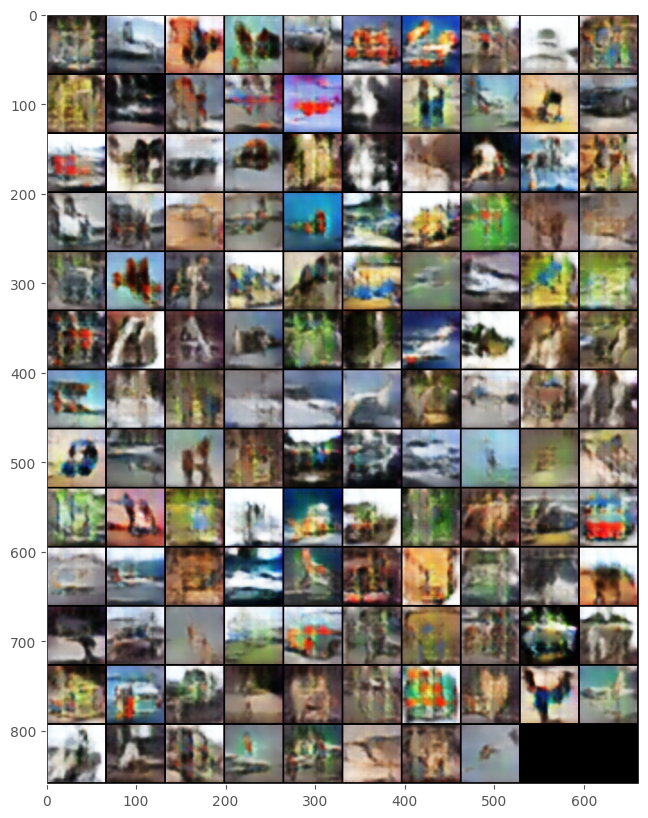

 33%|███▎      | 10/30 [18:45<35:40, 107.04s/it, Epoch=10/30, Step=200/390, D_Loss=0.5084, G_Loss=1.1334, D(x)=0.50, D(G(z))=0.19]

Saving fake_images_cifar-0011.png


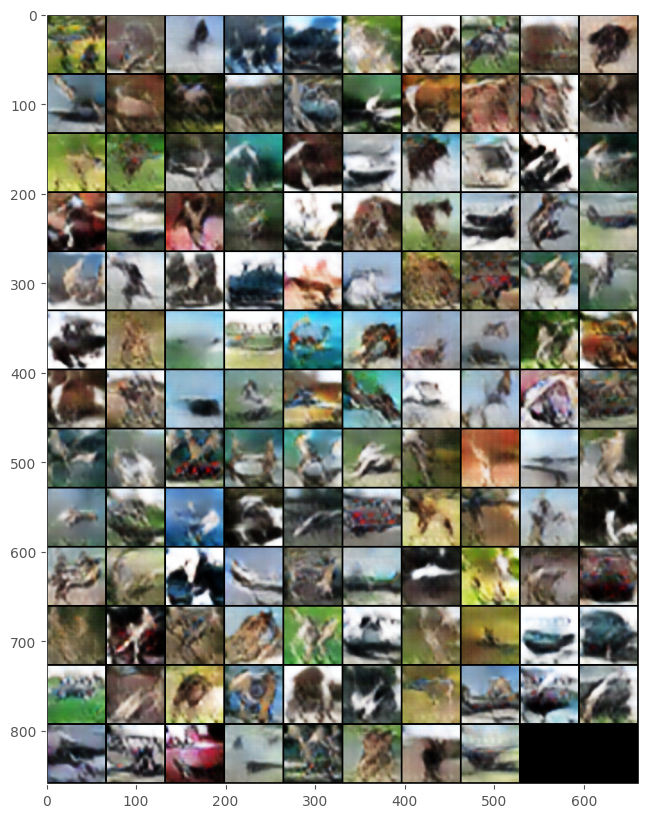

 37%|███▋      | 11/30 [20:32<33:55, 107.12s/it, Epoch=11/30, Step=200/390, D_Loss=0.7720, G_Loss=3.0373, D(x)=0.95, D(G(z))=0.73]

Saving fake_images_cifar-0012.png


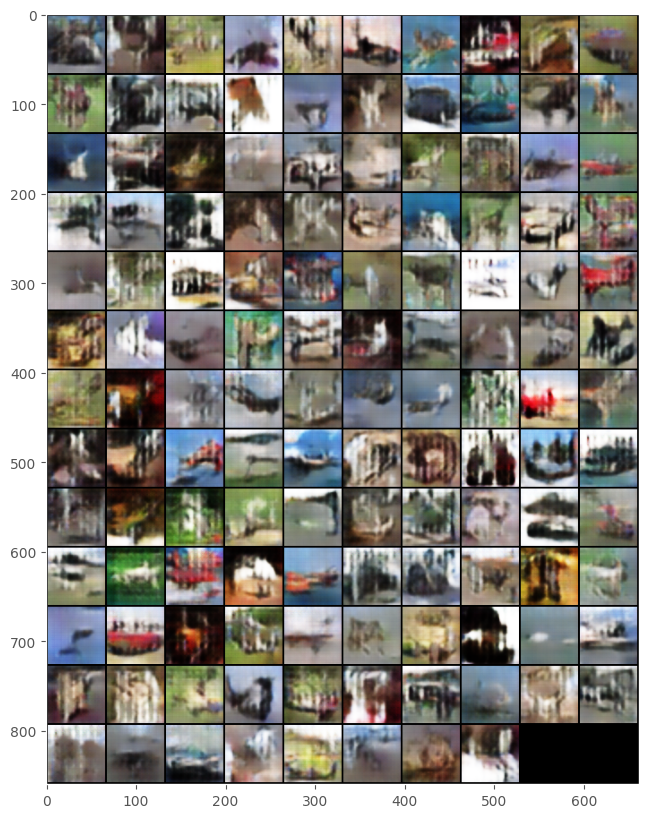

 40%|████      | 12/30 [22:19<32:08, 107.13s/it, Epoch=12/30, Step=200/390, D_Loss=0.6199, G_Loss=1.4246, D(x)=0.51, D(G(z))=0.35]

Saving fake_images_cifar-0013.png


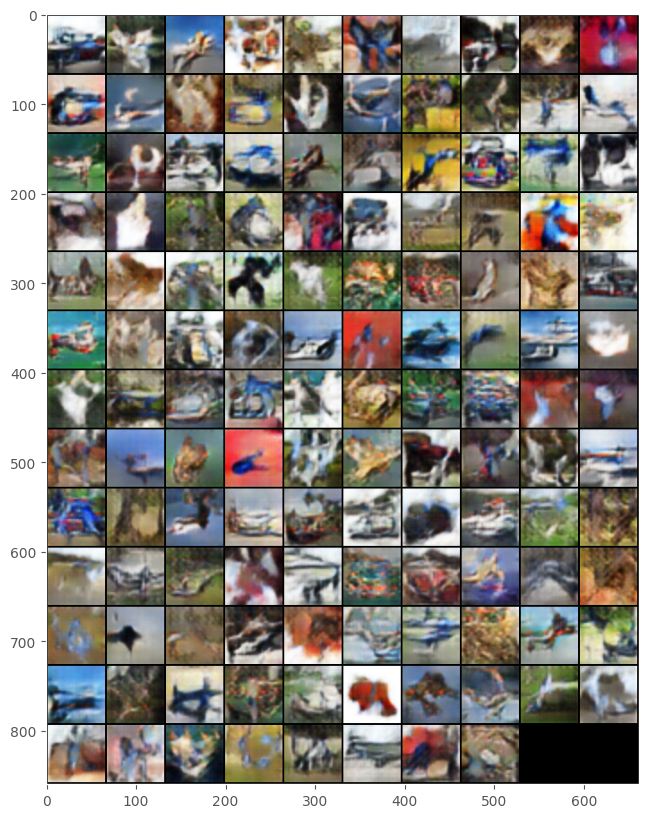

 43%|████▎     | 13/30 [24:06<30:19, 107.05s/it, Epoch=13/30, Step=200/390, D_Loss=0.4307, G_Loss=2.0852, D(x)=0.66, D(G(z))=0.29]

Saving fake_images_cifar-0014.png


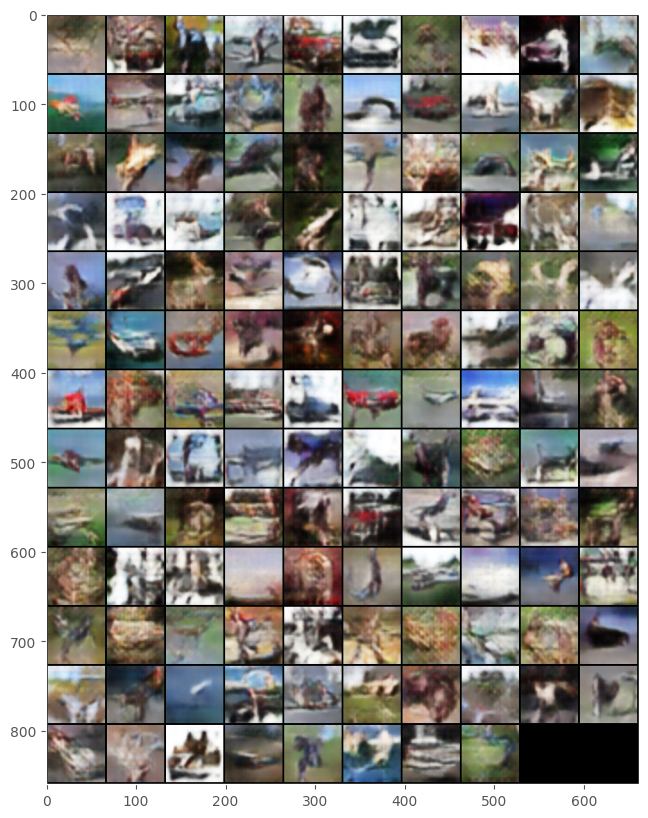

 47%|████▋     | 14/30 [25:53<28:32, 107.03s/it, Epoch=14/30, Step=200/390, D_Loss=0.1453, G_Loss=3.4521, D(x)=0.95, D(G(z))=0.20]

Saving fake_images_cifar-0015.png


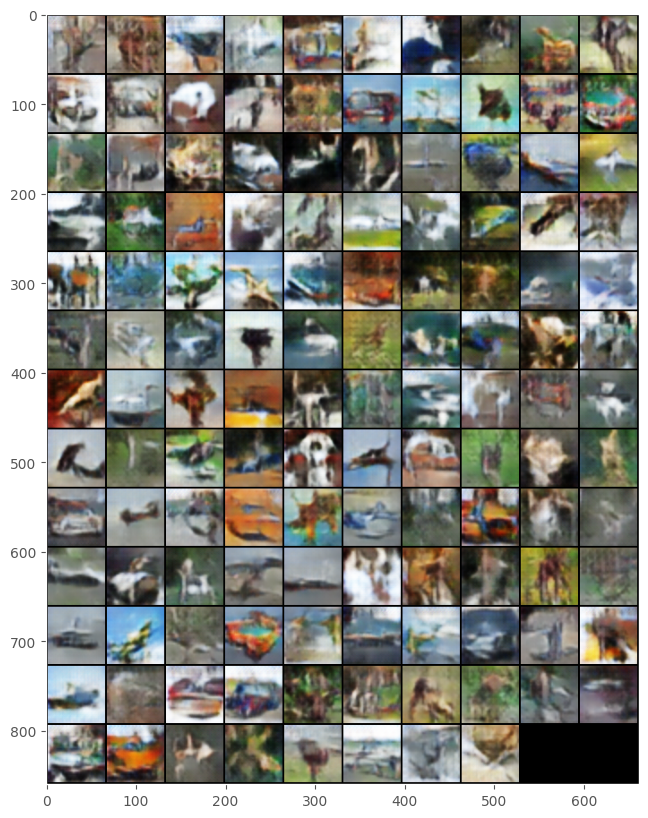

 50%|█████     | 15/30 [27:40<26:45, 107.02s/it, Epoch=15/30, Step=200/390, D_Loss=0.9045, G_Loss=0.6967, D(x)=0.24, D(G(z))=0.10]

Saving fake_images_cifar-0016.png


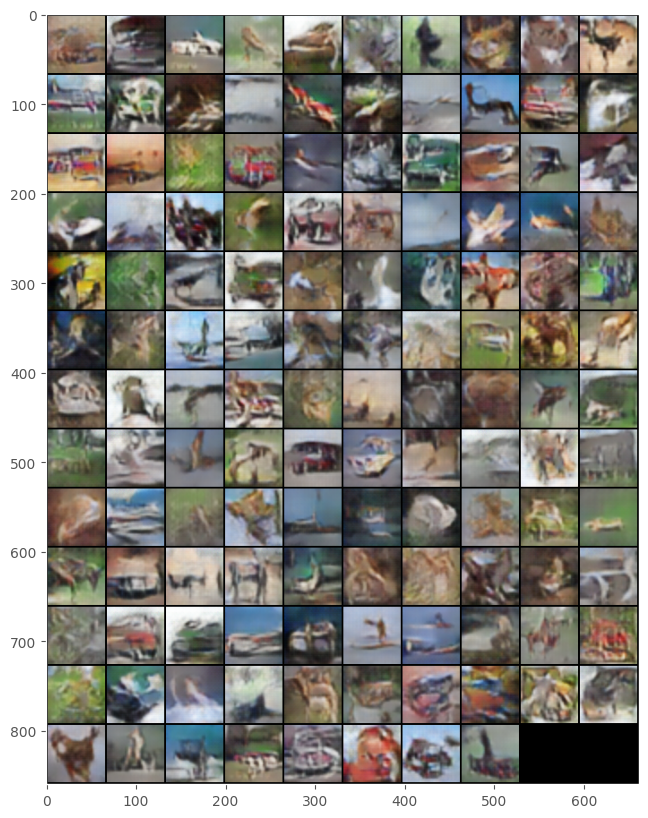

 53%|█████▎    | 16/30 [29:27<24:57, 106.94s/it, Epoch=16/30, Step=200/390, D_Loss=0.2738, G_Loss=2.1083, D(x)=0.74, D(G(z))=0.19]

Saving fake_images_cifar-0017.png


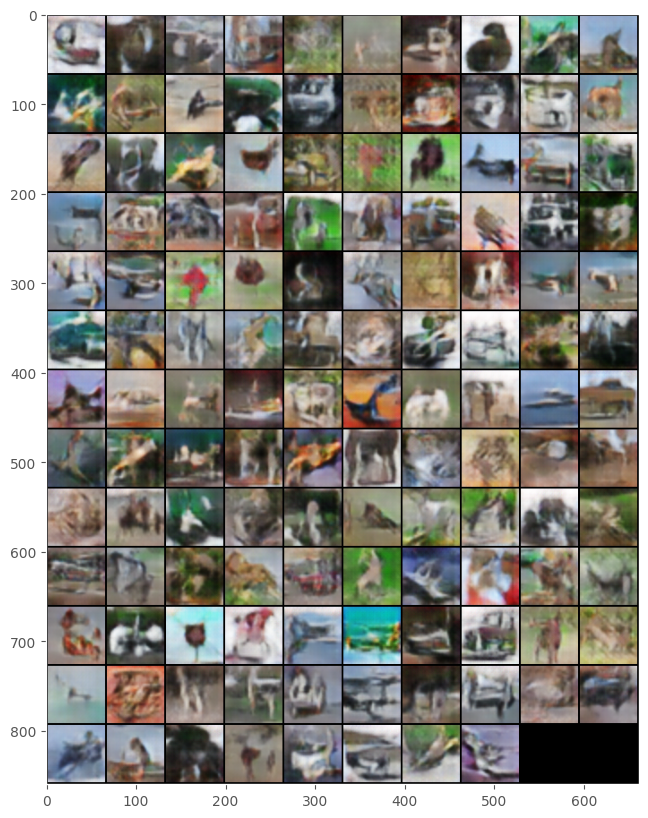

 57%|█████▋    | 17/30 [31:14<23:09, 106.91s/it, Epoch=17/30, Step=200/390, D_Loss=1.9300, G_Loss=0.5091, D(x)=0.04, D(G(z))=0.00]

Saving fake_images_cifar-0018.png


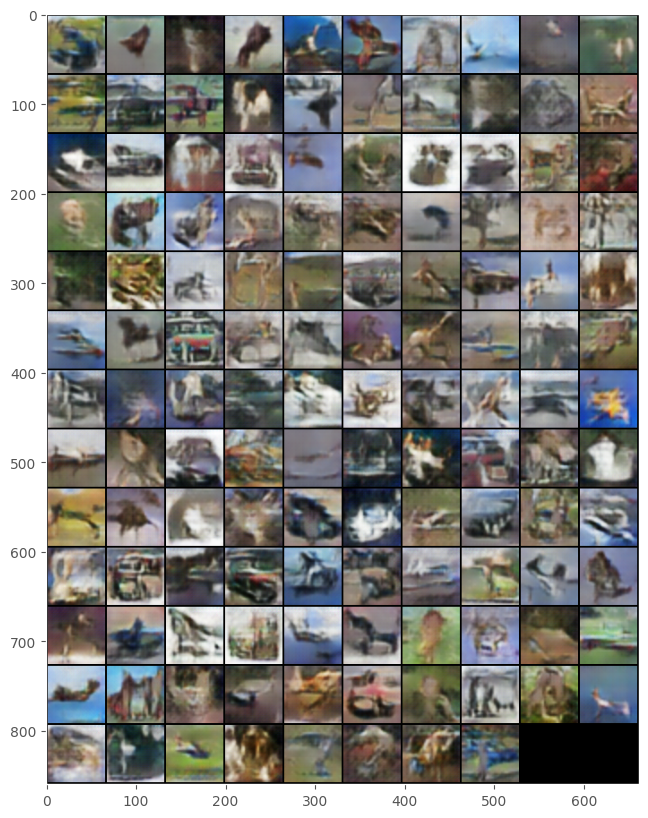

 60%|██████    | 18/30 [33:01<21:22, 106.91s/it, Epoch=18/30, Step=200/390, D_Loss=0.2721, G_Loss=1.8067, D(x)=0.75, D(G(z))=0.20]

Saving fake_images_cifar-0019.png


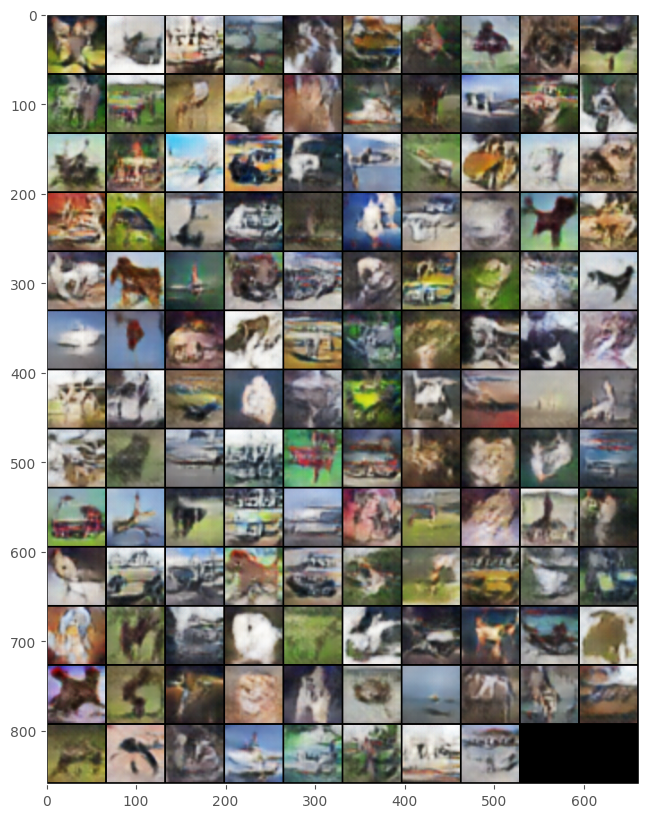

 63%|██████▎   | 19/30 [34:47<19:35, 106.85s/it, Epoch=19/30, Step=200/390, D_Loss=0.2725, G_Loss=2.4562, D(x)=0.63, D(G(z))=0.01]

Saving fake_images_cifar-0020.png


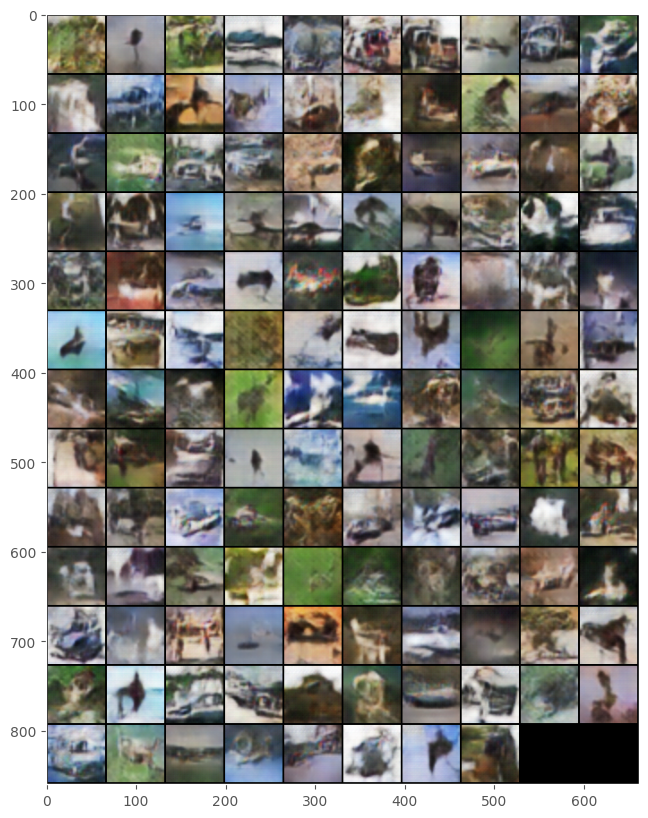

 67%|██████▋   | 20/30 [36:34<17:47, 106.80s/it, Epoch=20/30, Step=200/390, D_Loss=0.1589, G_Loss=4.9128, D(x)=0.99, D(G(z))=0.24]

Saving fake_images_cifar-0021.png


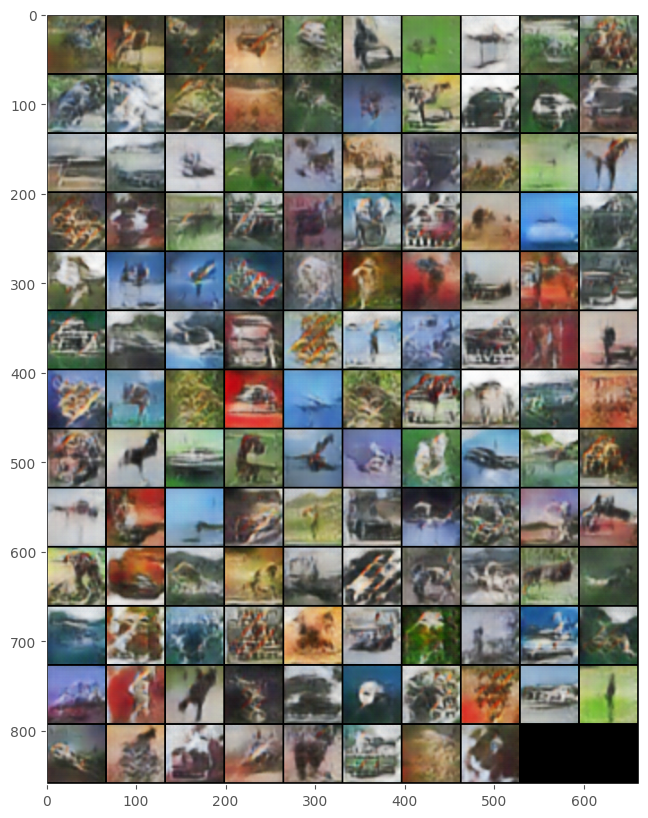

 70%|███████   | 21/30 [38:21<16:01, 106.81s/it, Epoch=21/30, Step=200/390, D_Loss=0.5651, G_Loss=0.9766, D(x)=0.60, D(G(z))=0.36]

Saving fake_images_cifar-0022.png


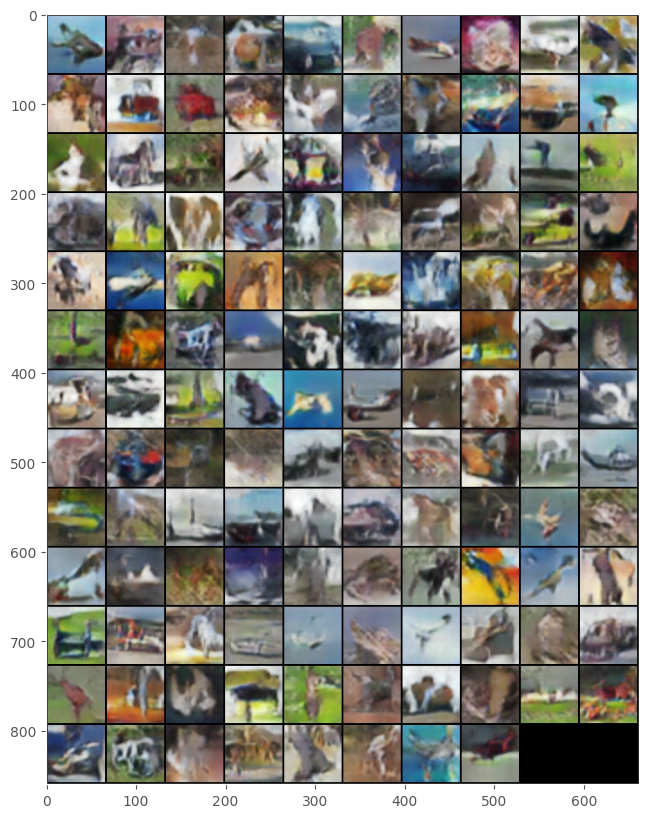

 73%|███████▎  | 22/30 [40:08<14:14, 106.75s/it, Epoch=22/30, Step=200/390, D_Loss=0.5846, G_Loss=0.8249, D(x)=0.40, D(G(z))=0.10]

Saving fake_images_cifar-0023.png


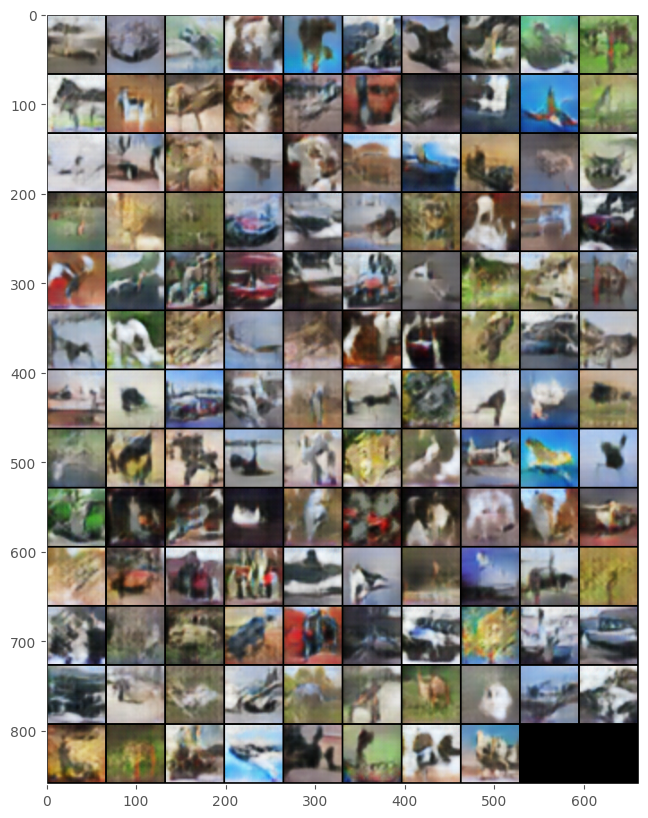

 77%|███████▋  | 23/30 [41:54<12:27, 106.79s/it, Epoch=23/30, Step=200/390, D_Loss=0.0225, G_Loss=4.6841, D(x)=0.97, D(G(z))=0.02]

Saving fake_images_cifar-0024.png


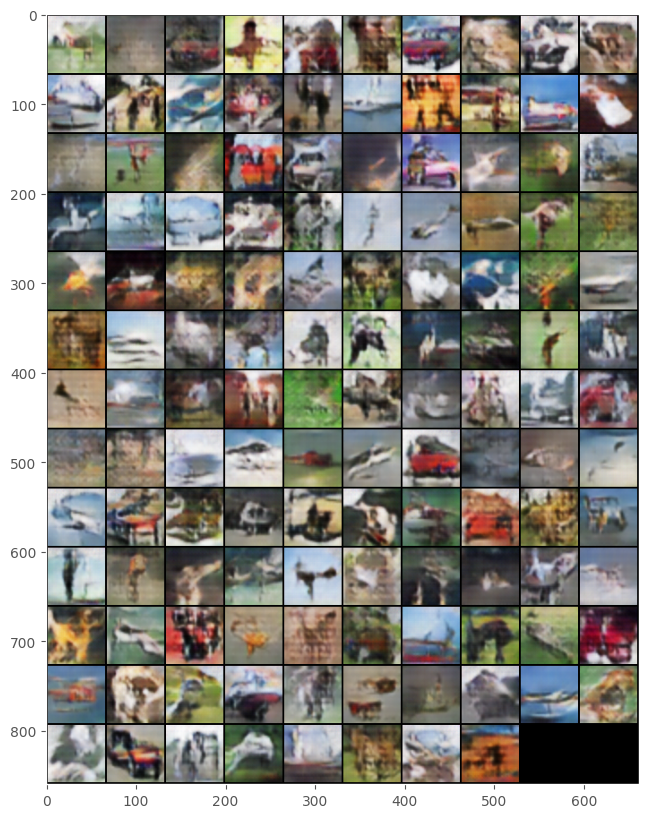

 80%|████████  | 24/30 [43:41<10:40, 106.81s/it, Epoch=24/30, Step=200/390, D_Loss=0.4137, G_Loss=2.3616, D(x)=0.79, D(G(z))=0.40]

Saving fake_images_cifar-0025.png


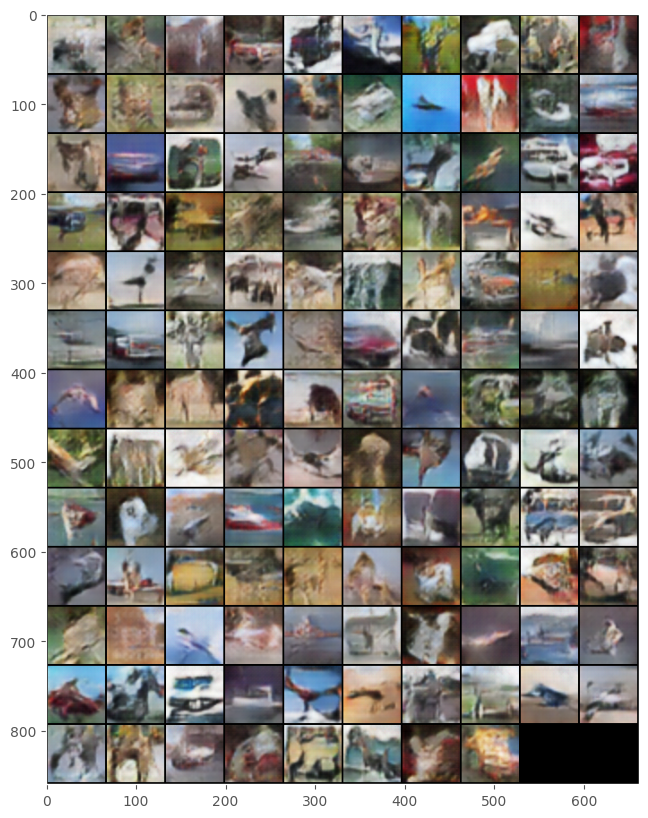

 83%|████████▎ | 25/30 [45:28<08:53, 106.79s/it, Epoch=25/30, Step=200/390, D_Loss=0.0323, G_Loss=3.9407, D(x)=0.96, D(G(z))=0.02]

Saving fake_images_cifar-0026.png


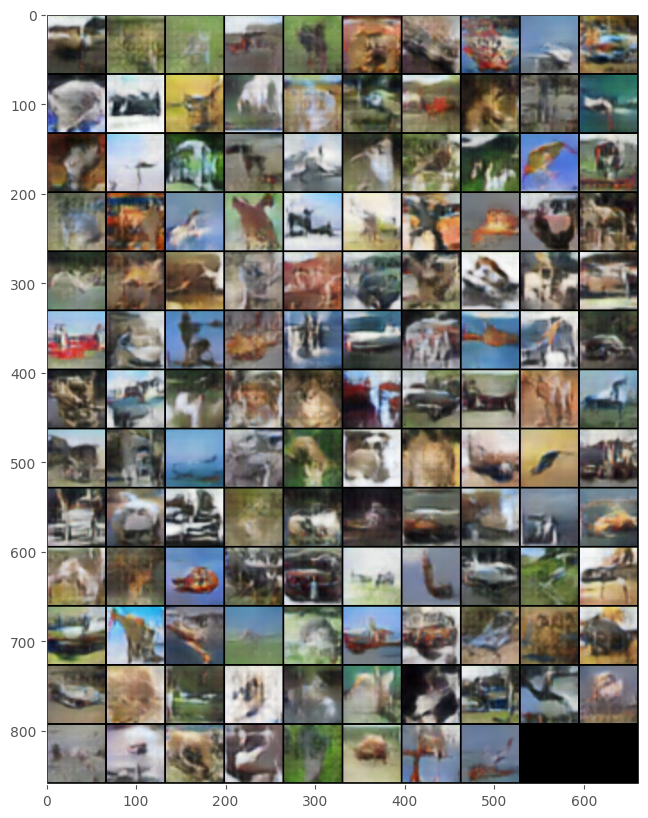

 87%|████████▋ | 26/30 [47:15<07:07, 106.79s/it, Epoch=26/30, Step=200/390, D_Loss=0.2831, G_Loss=1.3478, D(x)=0.65, D(G(z))=0.08]

Saving fake_images_cifar-0027.png


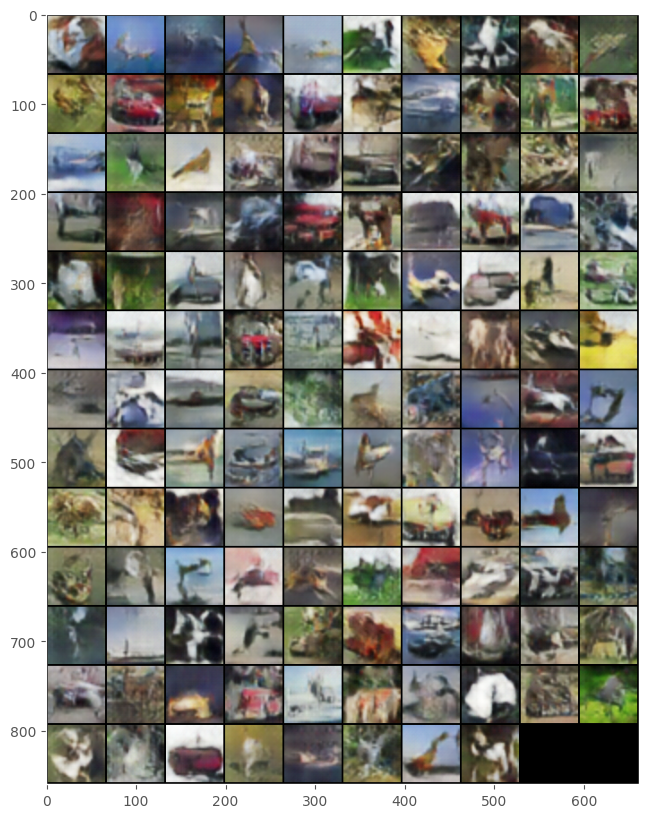

 90%|█████████ | 27/30 [49:02<05:20, 106.76s/it, Epoch=27/30, Step=200/390, D_Loss=0.0603, G_Loss=2.8853, D(x)=0.94, D(G(z))=0.06]

Saving fake_images_cifar-0028.png


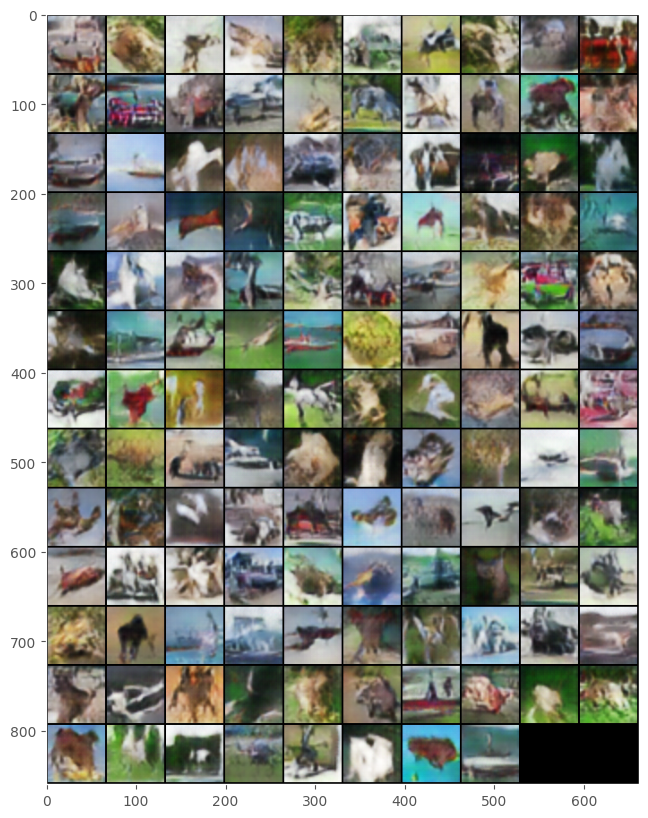

 93%|█████████▎| 28/30 [50:48<03:33, 106.80s/it, Epoch=28/30, Step=200/390, D_Loss=0.1959, G_Loss=2.7791, D(x)=0.83, D(G(z))=0.16]

Saving fake_images_cifar-0029.png


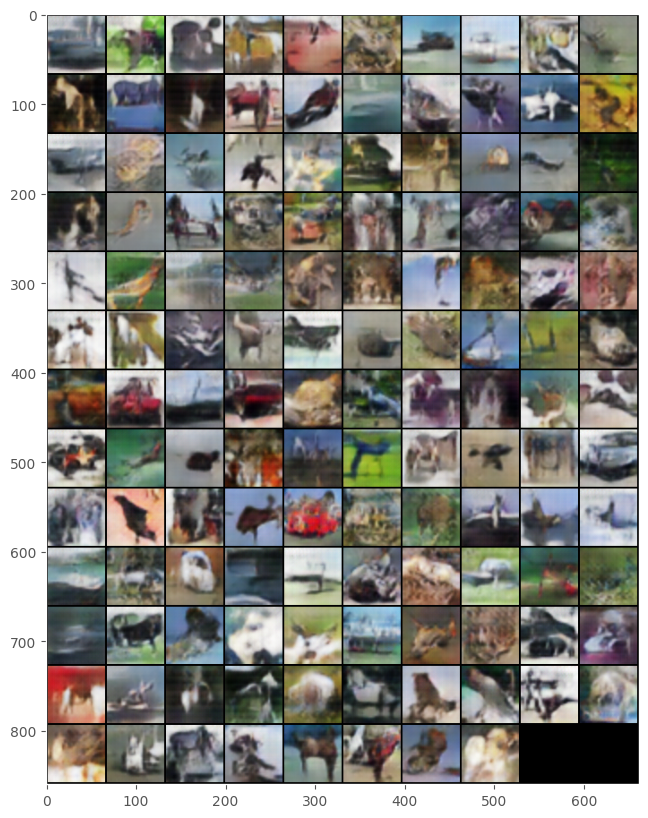

 97%|█████████▋| 29/30 [52:35<01:46, 106.78s/it, Epoch=29/30, Step=200/390, D_Loss=0.5056, G_Loss=1.3058, D(x)=0.86, D(G(z))=0.49]

Saving fake_images_cifar-0030.png


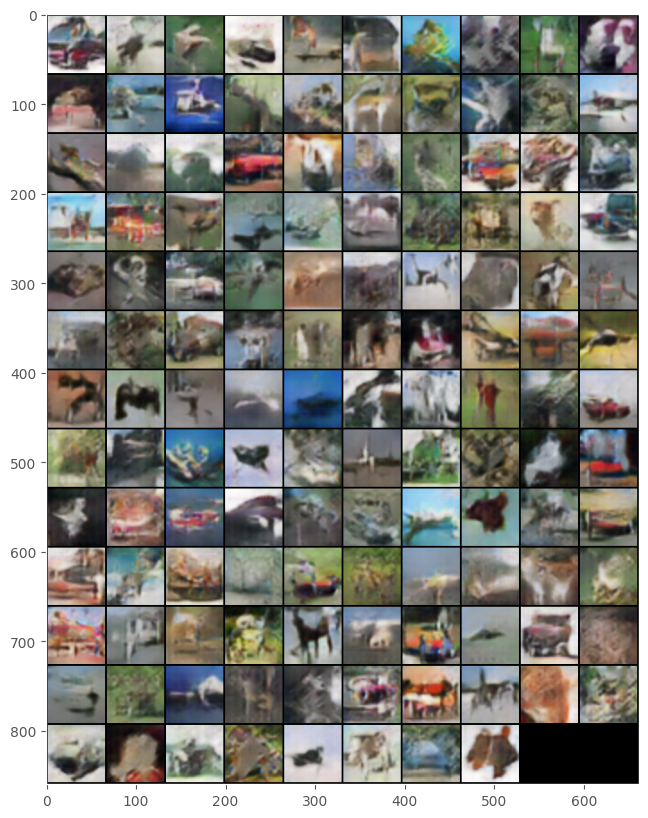

100%|██████████| 30/30 [53:28<00:00, 106.93s/it, Epoch=29/30, Step=200/390, D_Loss=0.5056, G_Loss=1.3058, D(x)=0.86, D(G(z))=0.49]

CPU times: user 56min 48s, sys: 1min 1s, total: 57min 50s
Wall time: 53min 28s


In [22]:
%%time
num_epochs = CFG.num_epochs
batch_size = CFG.batch_size

total_step = len(data_loader)
d_losses, g_losses, real_scores, fake_scores = [], [], [], []
DCG.to(device)
DCD.to(device)

cur_tqdm = tqdm(range(num_epochs), position=0, leave=True)

for epoch in cur_tqdm:
    for i, (images, _) in enumerate(data_loader):
        # Load a batch & transform to vectors
        images = images.to(device)
        
        # Train the discriminator
        d_loss, real_score, fake_score = train_discriminator(DCD, DCG, images)
        
        # Train the generator
        g_loss, fake_images = train_generator(DCG, DCD)

        # Inspect the losses
        if (i + 1) % 200 == 0:
            d_losses.append(d_loss.item())
            g_losses.append(g_loss.item())
            real_scores.append(real_score.mean().item())
            fake_scores.append(fake_score.mean().item())
            
            show_dict = {'Epoch': f'{epoch}/{num_epochs}',
                         'Step': f'{i + 1}/{total_step}',
                         'D_Loss': f'{d_loss.item():.4f}',
                         'G_Loss': f'{g_loss.item():.4f}',
                         'D(x)': f'{real_score.mean().item():.2f}',
                         'D(G(z))': f'{fake_score.mean().item():.2f}'}
            cur_tqdm.set_postfix(show_dict)
            
    # Sample and save images
    save_fake_images_cifar(DCG, epoch + 1, show_image=True)

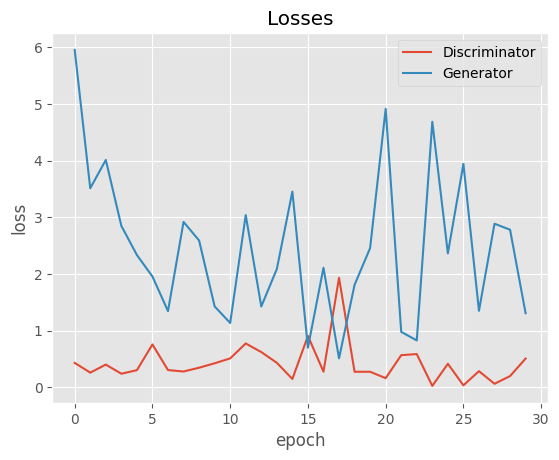

In [23]:
# show the discrimator loss and generator loss
plt.plot(d_losses, "-")
plt.plot(g_losses, "-")
plt.xlabel("epoch")
plt.ylabel("loss")
plt.legend(["Discriminator", "Generator"])
plt.title("Losses");

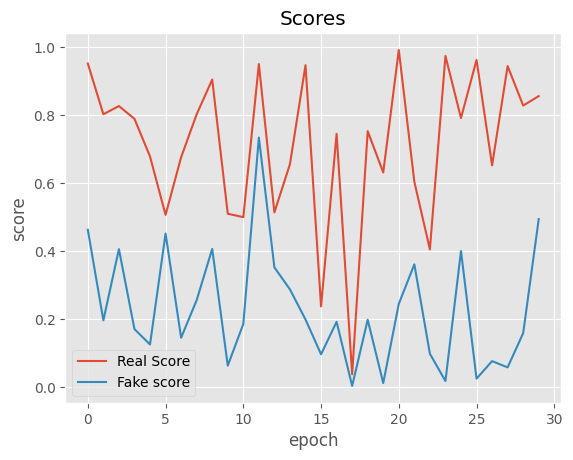

In [24]:
# plot the accuracy of discrimator
plt.plot(real_scores, "-")
plt.plot(fake_scores, "-")
plt.xlabel("epoch")
plt.ylabel("score")
plt.legend(["Real Score", "Fake score"])
plt.title("Scores");

In [25]:
torch.save(DCG, 'dcgan-G-2.pth')

In [26]:
torch.save(DCD, 'dcgan-D-2.pth')

Saving fake_images_cifar_test.png


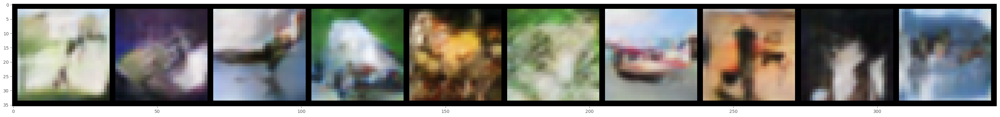

In [30]:
transform = transforms.Compose([
    transforms.Resize([32, 32]),
])

sample_vectors = torch.randn(10, CFG.nz, 1, 1).to(device)
fake_images = DCG(sample_vectors)

fake_images = fake_images.reshape(fake_images.size(0), 3, 64, 64)

fake_fname = "fake_images_cifar_test.png"
print("Saving", fake_fname)
path = os.path.join(CFG.sample_dir, fake_fname)
save_image(transform(denorm(fake_images)), path, nrow=10)

plt.figure(figsize=(40, 20))
plt.grid(False)
plt.imshow(np.asarray(Image.open(path)))
plt.show()